# **Lane Detection System**

In [1]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


### Extracting the dataset

In [ ]:
import zipfile
import os

zip_file_path = '/content/drive/MyDrive/lanedataset/dl data.zip'
extracted_folder_path = '/content/drive/MyDrive/lanedataset/extracted'

with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extracted_folder_path)

# **Exploratory data analysis**

In [2]:
extracted_folder_path = '/content/drive/MyDrive/extracted/dl data'


Exploring the files of data set folder

In [3]:
import os

dl_data_contents = os.listdir(extracted_folder_path)
dl_data_contents

['06030819_0755.MP4',
 '06030843_0763.MP4',
 '06030834_0760.MP4',
 '06030828_0758.MP4',
 '06030837_0761.MP4',
 '06030840_0762.MP4',
 '06030825_0757.MP4',
 '06030822_0756.MP4',
 '06030846_0764.MP4',
 '06030831_0759.MP4']

The dataset comprises multiple MP4 folders; however, these folders do not contain video files but instead contain subfolders or data files.

Now lets explore one of the folders of the dataset

In [5]:
first_mp4_folder = os.path.join(extracted_folder_path, dl_data_contents[0])

first_mp4_folder_contents = os.listdir(first_mp4_folder)


first_mp4_folder_contents

['00720.jpg',
 '04590.jpg',
 '00090.jpg',
 '01620.lines.txt',
 '01440.lines.txt',
 '01260.lines.txt',
 '05310.lines.txt',
 '01170.jpg',
 '04140.jpg',
 '03960.lines.txt',
 '01890.lines.txt',
 '00450.jpg',
 '00000.lines.txt',
 '03690.lines.txt',
 '00900.jpg',
 '00810.lines.txt',
 '02520.jpg',
 '02340.lines.txt',
 '03420.lines.txt',
 '01080.lines.txt',
 '02610.lines.txt',
 '02700.lines.txt',
 '03600.jpg',
 '02250.jpg',
 '02250.lines.txt',
 '03060.lines.txt',
 '00900.lines.txt',
 '03780.lines.txt',
 '04230.jpg',
 '05310.jpg',
 '01980.jpg',
 '01980.lines.txt',
 '03870.lines.txt',
 '00810.jpg',
 '04860.jpg',
 '02430.jpg',
 '03060.jpg',
 '01350.lines.txt',
 '03510.jpg',
 '02880.lines.txt',
 '00540.jpg',
 '05220.lines.txt',
 '02790.jpg',
 '04320.jpg',
 '05040.lines.txt',
 '01890.jpg',
 '01710.lines.txt',
 '04590.lines.txt',
 '02340.jpg',
 '00180.jpg',
 '03150.lines.txt',
 '04770.lines.txt',
 '01710.jpg',
 '00630.jpg',
 '01260.jpg',
 '02970.jpg',
 '04050.jpg',
 '03510.lines.txt',
 '03330.lines.

The dataset encompasses both images and text files. The images depict road scenes, while the "lane.txt" files, sharing the same base name, provide coordinates that delineate the lanes within the respective images.

Now, lets explore few images from the first folder and check how many such images and text files are there in the dataset

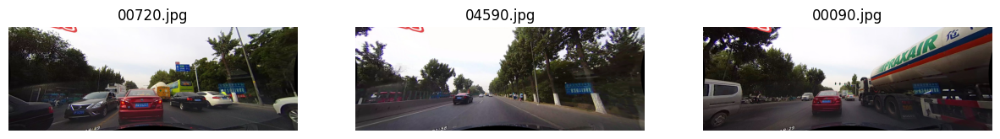

(60, 60, ['00720.jpg', '04590.jpg', '00090.jpg'])

In [6]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Choosing the first folder for exploration
sample_folder = os.path.join(extracted_folder_path, '06030819_0755.MP4')
sample_folder_contents = os.listdir(sample_folder)

# Filtering out JPEG images and text files
jpeg_files = [f for f in sample_folder_contents if f.endswith('.jpg')]
text_files = [f for f in sample_folder_contents if f.endswith('.lines.txt')]

# Displaying number of text and image files in that folder
num_jpeg_files = len(jpeg_files)
num_text_files = len(text_files)

# Displaying images
num_samples_to_display = 3
sample_images = jpeg_files[:num_samples_to_display]

plt.figure(figsize=(15, 5))
for i, image_file in enumerate(sample_images):
    img_path = os.path.join(sample_folder, image_file)
    img = mpimg.imread(img_path)
    plt.subplot(1, num_samples_to_display, i + 1)
    plt.imshow(img)
    plt.title(image_file)
    plt.axis('off')

plt.show()

(num_jpeg_files, num_text_files, sample_images)


Now lets explore one of the line.txt file from the first folder

In [11]:
# Reading the contents of the a text file from the first folder
sample_text_file = next((file for file in first_mp4_folder_contents if file.endswith('.lines.txt')), None)
sample_text_file_path = os.path.join(first_mp4_folder, sample_text_file) if sample_text_file else None
text_file_content = ""
if sample_text_file_path:
    with open(sample_text_file_path, 'r') as file:
        text_file_content = file.read()

text_file_content

'159.454 590 184.924 580 213.223 570 242.203 560 270.502 550 298.539 540 326.839 530 355.819 520 384.118 510 412.418 500 440.947 490 469.247 480 497.546 470 525.845 460 554.374 450 582.674 440 610.973 430 \n478.356 590 490.314 580 503.068 570 516.327 560 529.879 550 543.138 540 556.397 530 569.152 520 582.704 510 596.256 500 608.854 490 622.406 480 635.161 470 648.713 460 662.108 450 674.863 440 688.415 430 \n1013.95 590 1003.07 580 990.632 570 977.89 560 965.453 550 953.487 540 941.05 530 929.084 520 916.648 510 904.212 500 891.568 490 879.131 480 866.695 470 854.258 460 842.392 450 829.955 440 817.519 430 \n1564.15 590 1529.3 580 1490.58 570 1452.09 560 1413.37 550 1374.87 540 1336.15 530 1297.66 520 1258.94 510 1220.22 500 1182.24 490 1143.52 480 1104.8 470 1066.08 460 1027.14 450 988.418 440 950.664 430 \n'

Lets see the dimensions of the images in the dataset

In [9]:
import pandas as pd

# Function that analyze the dimensions of images
def analyze_image_dimensions(folder_path, image_files):
    dimensions = []
    for image_file in image_files:
        img_path = os.path.join(folder_path, image_file)
        img = mpimg.imread(img_path)
        dimensions.append(img.shape)
    return pd.DataFrame(dimensions, columns=['Height', 'Width', 'Channels'])

# Analyzing the dimensions of the images in the first folder
image_dimensions_df = analyze_image_dimensions(sample_folder, jpeg_files)

image_dimensions_stats = image_dimensions_df.describe()
image_dimensions_stats


,Height,Width,Channels
count,60.0,60.0,60.0
mean,590.0,1640.0,3.0
std,0.0,0.0,0.0
min,590.0,1640.0,3.0
25%,590.0,1640.0,3.0
50%,590.0,1640.0,3.0
75%,590.0,1640.0,3.0
max,590.0,1640.0,3.0


Here we see that all the images are of same hight (590) and same width (1640). All images are RGB as expected

Now, let's analyze the x and y coordinates in the text files

In [10]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np

def extract_coordinates(text_file_path):
    """
    Extract coordinates from a text file.
    Args:
    - text_file_path: Path to the text file with lane marking coordinates.
    Returns:
    - A DataFrame with coordinates and line identifiers.
    """
    with open(text_file_path, 'r') as file:
        lines = file.readlines()

    # Extracting coordinates from each line
    data = []
    for line_id, line in enumerate(lines):
        coords = line.strip().split()
        for i in range(0, len(coords), 2):
            x = float(coords[i])
            y = float(coords[i+1])
            data.append([line_id, x, y])

    return pd.DataFrame(data, columns=['LineID', 'X', 'Y'])

# Extracting coordinates from multiple text files for analysis
coordinate_data = pd.DataFrame(columns=['LineID', 'X', 'Y'])
for text_file_name in text_files[:10]:  # Limiting to first 10 files for demonstration
    text_file_path = os.path.join(sample_folder, text_file_name)
    coordinate_data = coordinate_data.append(extract_coordinates(text_file_path), ignore_index=True)

coordinate_data.head()


,LineID,X,Y
0,0,159.454,590.0
1,0,184.924,580.0
2,0,213.223,570.0
3,0,242.203,560.0
4,0,270.502,550.0


Now, lets marks the lines which represent the lanes on few images of the first folder

/content/drive/MyDrive/extracted/dl data/06030819_0755.MP4/04590.jpg
/content/drive/MyDrive/extracted/dl data/06030819_0755.MP4/04590.lines.txt


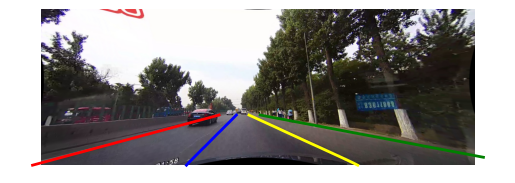

/content/drive/MyDrive/extracted/dl data/06030819_0755.MP4/00090.jpg
/content/drive/MyDrive/extracted/dl data/06030819_0755.MP4/00090.lines.txt


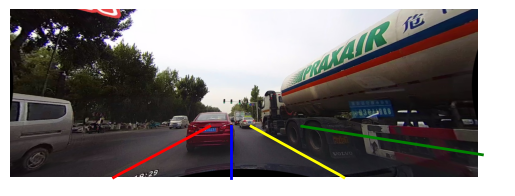

/content/drive/MyDrive/extracted/dl data/06030819_0755.MP4/01170.jpg
/content/drive/MyDrive/extracted/dl data/06030819_0755.MP4/01170.lines.txt


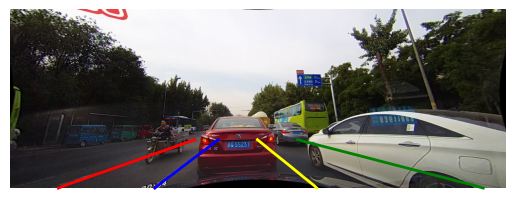

In [ ]:
additional_samples = 3
additional_sample_images = jpeg_files[1:1+additional_samples]
# Function to plot lane markings with different colors
def plot_lane_markings(image_path, text_file_path):
    print(image_path)
    print(text_file_path)
    image = mpimg.imread(image_path)

    # Read coordinates from the text file
    with open(text_file_path, 'r') as file:
        lane_coordinates = file.readlines()

    colors = ['red', 'blue', 'yellow', 'green']

    fig, ax = plt.subplots()
    ax.imshow(image)

    # Plot each set of coordinates as a line on the image
    for i, line in enumerate(lane_coordinates):
        coords = line.strip().split()
        x = [float(coords[j]) for j in range(0, len(coords), 2)]
        y = [float(coords[j]) for j in range(1, len(coords), 2)]
        ax.plot(x, y, color=colors[i % len(colors)], linewidth=2)

    plt.axis('off')
    plt.show()

# Visualizing lane markings on additional sample images with corrected matching
for sample_image_name in additional_sample_images:
    base_name = sample_image_name.split('.')[0]  # Base name without extension
    corresponding_text_file_name = f"{base_name}.lines.txt"  # Corresponding text file name

    # Constructing full paths
    image_path = os.path.join(sample_folder, sample_image_name)
    text_file_path = os.path.join(sample_folder, corresponding_text_file_name)

    # Visualizing lane markings on the image
    plot_lane_markings(image_path, text_file_path)


Now lets analyse if the lines are only straight or curved as well

In [ ]:
from scipy.spatial.distance import euclidean
from math import atan2, degrees

def calculate_angle(p1, p2, p3):
    """
    Calculate the angle formed by three points.
    Args:
    - p1, p2, p3: Points in the format (x, y).
    Returns:
    - Angle in degrees.
    """
    a = np.array(p1)
    b = np.array(p2)
    c = np.array(p3)

    ba = a - b
    bc = c - b

    cosine_angle = np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc))
    angle = np.arccos(cosine_angle)

    return np.degrees(angle)

def categorize_lane(coordinates):
    """
    Categorize a lane based on its curvature.
    Args:
    - coordinates: DataFrame with coordinates of a lane.
    Returns:
    - Category of the lane: 'Straight' or 'Curved'.
    """
    angles = []
    for i in range(1, len(coordinates) - 1):
        angle = calculate_angle(coordinates.iloc[i-1], coordinates.iloc[i], coordinates.iloc[i+1])
        angles.append(angle)

    # Simple heuristic: If average angle deviation is small, it's a straight line; else, it's curved
    average_deviation = np.mean(np.abs(np.array(angles) - 180))
    return 'Straight' if average_deviation < 10 else 'Curved'  # 10 degrees chosen arbitrarily as a threshold

# Analyzing and categorizing the lanes in the first few text files
lane_categories = {}
for text_file_name in text_files[:5]:  # Limiting to first 5 files for demonstration
    base_name = text_file_name.split('.')[0]
    text_file_path = os.path.join(sample_folder, text_file_name)
    coordinates = extract_coordinates(text_file_path)

    # Categorizing each line in the text file
    grouped = coordinates.groupby('LineID')
    for name, group in grouped:
        category = categorize_lane(group[['X', 'Y']])
        lane_categories[f"{base_name}_Line_{name}"] = category

lane_categories


{'01620_Line_0': 'Straight',
 '01620_Line_1': 'Straight',
 '01620_Line_2': 'Straight',
 '01620_Line_3': 'Curved',
 '01440_Line_0': 'Straight',
 '01440_Line_1': 'Straight',
 '01440_Line_2': 'Straight',
 '01440_Line_3': 'Curved',
 '01260_Line_0': 'Straight',
 '01260_Line_1': 'Straight',
 '01260_Line_2': 'Straight',
 '01260_Line_3': 'Curved',
 '05310_Line_0': 'Straight',
 '05310_Line_1': 'Curved',
 '05310_Line_2': 'Curved',
 '05310_Line_3': 'Curved',
 '03960_Line_0': 'Straight',
 '03960_Line_1': 'Curved',
 '03960_Line_2': 'Straight'}

In most of the cases, the first two or three lines in each image are categorized as 'Straight'. This could mean that these lines are relatively linear with only minor deviations.
The last line in each image is often categorized as 'Curved', indicating a significant deviation from a straight path, which suggests more pronounced turns or bends in these lines.


Now lets Calculate the curvature of a lane marking

In [ ]:
def calculate_curvature(coordinates):
    """
    Calculate the curvature of a lane marking.
    Args:
    - coordinates: DataFrame with coordinates of a single lane marking.
    Returns:
    - Average curvature of the lane marking.
    """
    def angle_between_three_points(p0, p1, p2):
        """ Calculate the angle formed by three points. """
        a = np.array(p0)
        b = np.array(p1)
        c = np.array(p2)

        ba = a - b
        bc = c - b

        cosine_angle = np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc))
        angle = np.arccos(cosine_angle)
        return np.degrees(angle)

    curvatures = []
    total_length = 0
    for i in range(1, len(coordinates) - 1):
        p0 = coordinates.iloc[i - 1]
        p1 = coordinates.iloc[i]
        p2 = coordinates.iloc[i + 1]

        # Calculating angle change
        angle_change = angle_between_three_points(p0, p1, p2)

        # Calculating segment length
        segment_length = euclidean(p0, p1)
        total_length += segment_length

        # Calculating curvature (angle change per unit length)
        if segment_length != 0:
            curvature = angle_change / segment_length
            curvatures.append(curvature)

    # Averaging the curvature over the length of the lane marking
    average_curvature = np.mean(curvatures) if curvatures else 0
    return average_curvature

# Calculating curvature for a few sample lane markings
curvature_values = []
for text_file_name in text_files[:5]:  # Limiting to first 5 files for demonstration
    text_file_path = os.path.join(sample_folder, text_file_name)
    coordinates = extract_coordinates(text_file_path)
    grouped = coordinates.groupby('LineID')
    for name, group in grouped:
        curvature = calculate_curvature(group[['X', 'Y']])
        curvature_values.append(curvature)

curvature_values[:10]  # Displaying the first 10 curvature values


[6.006145822208242,
 10.85403807848081,
 11.32109823386532,
 nan,
 6.006145822208242,
 10.85403807848081,
 11.32109823386532,
 nan,
 6.006145822208242,
 10.85403807848081]

Values like 6.006145822208242 and 10.85403807848081 suggest varying degrees of curvature. A value around 6 indicates a gentle curve, while a value around 10 implies a more pronounced curve.

 These curvature values can help in understanding the nature of the road. For instance, a road with higher curvature values might require more careful navigation, especially at higher speeds.

Lets visualizes the distribution of curvature values for the lane markings

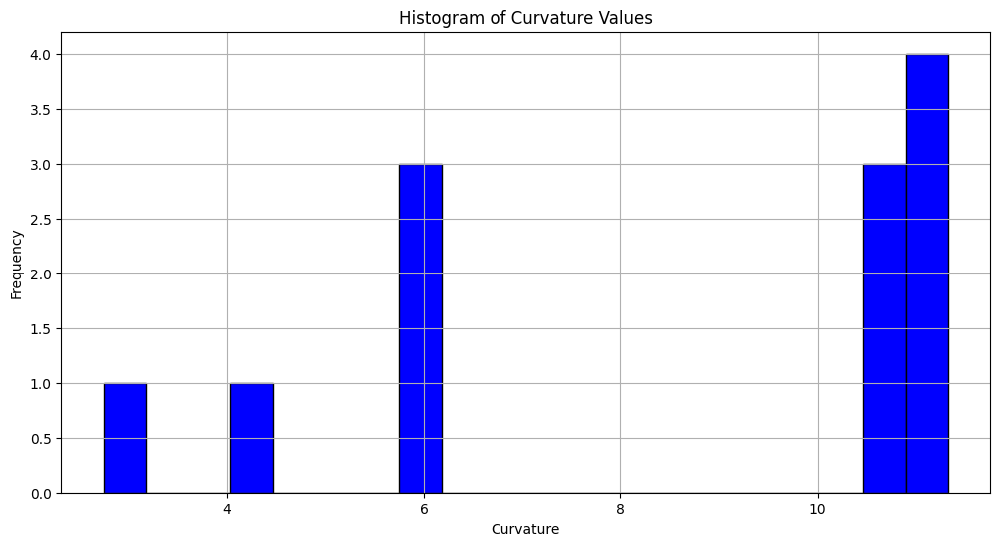

In [ ]:
import matplotlib.pyplot as plt

# Filtering out NaN values for plotting
curvature_values_filtered = [val for val in curvature_values if not np.isnan(val)]

# Plotting Histogram of Curvature Values
plt.figure(figsize=(12, 6))
plt.hist(curvature_values_filtered, bins=20, color='blue', edgecolor='black')
plt.title('Histogram of Curvature Values')
plt.xlabel('Curvature')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()



The histogram shows three distinct peaks around the curvature values of approximately 4, 6, and 10.
The peaks at around 6 and 10 are higher, suggesting that lane markings with these curvature values are more frequent in your dataset.
The presence of these peaks might indicate common road curvatures within the sampled data, such as gentle curves around 6 and sharper turns around 10.

The absence of bars near the curvature value of 0 suggests that there are very few or no perfectly straight lane markings in the sampled data, or that the chosen method of curvature calculation and thresholding doesn't yield values near 0.
The peak around 10, which is quite high, may suggest a prevalence of road segments with significant curvature, which could be important for applications like autonomous driving or driver assistance systems to note, as they may require more careful navigation.


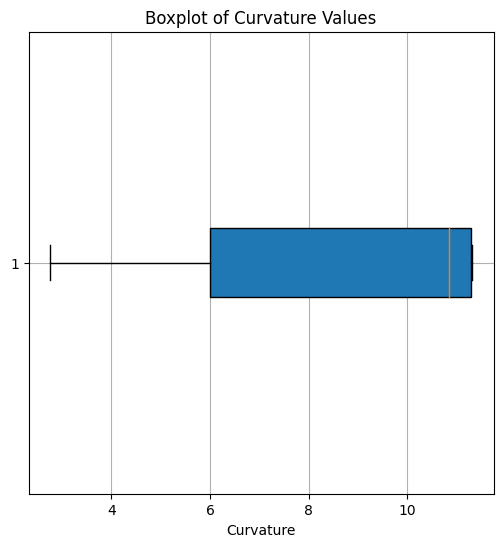

In [ ]:

# Plotting Boxplot of Curvature Values
plt.figure(figsize=(6, 6))
plt.boxplot(curvature_values_filtered, vert=False, patch_artist=True)
plt.title('Boxplot of Curvature Values')
plt.xlabel('Curvature')
plt.grid(True)
plt.show()



The boxplot indicates that the curvature values of the lane markings are mostly consistent, with a median suggesting mild curvature. There are no extreme values or outliers, implying uniformity in the curvature across the dataset. The data is concentrated within a narrow interquartile range, showing little variability in lane curvature.







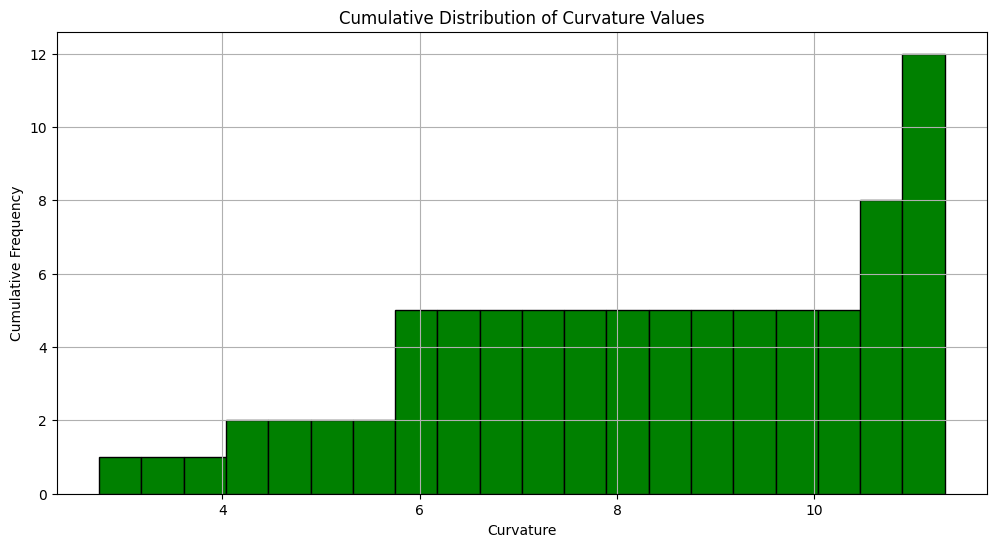

In [ ]:
# Plotting Cumulative Distribution of Curvature Values
plt.figure(figsize=(12, 6))
plt.hist(curvature_values_filtered, bins=20, cumulative=True, color='green', edgecolor='black')
plt.title('Cumulative Distribution of Curvature Values')
plt.xlabel('Curvature')
plt.ylabel('Cumulative Frequency')
plt.grid(True)
plt.show()

The cumulative distribution plot for curvature values indicates that the frequency of lane markings steadily increases with curvature. The steeper rises in the plot correspond to curvature values where there is a higher frequency of lane markings. The majority of lane markings have a curvature of 10 or less, with the distribution plateauing as it approaches this upper bound.







In [ ]:
curvature_df = pd.DataFrame({
    'Curvature': curvature_values,
    'Category': ['Curved' if value > 10 else 'Straight' for value in curvature_values]
})

# Dropping NaN values for accurate visualization
curvature_df = curvature_df.dropna()

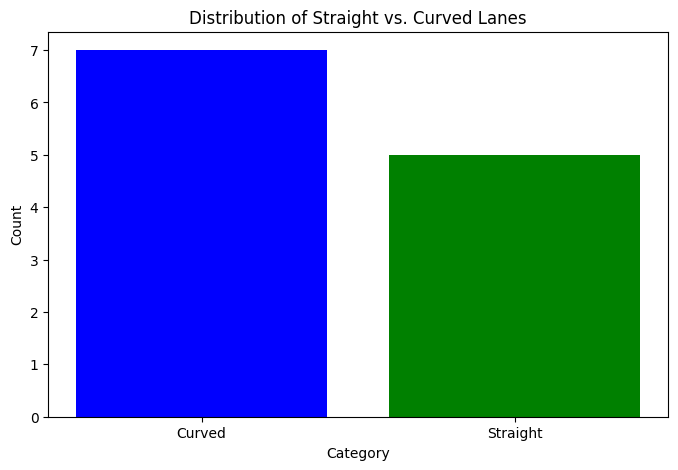

In [ ]:
category_counts = curvature_df['Category'].value_counts()
plt.figure(figsize=(8, 5))
plt.bar(category_counts.index, category_counts.values, color=['blue', 'green'])
plt.title('Distribution of Straight vs. Curved Lanes')
plt.xlabel('Category')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.show()

The bar chart displays the count of lane markings categorized as 'Curved' and 'Straight' based on their curvature values. The 'Curved' category has a higher count, indicating that there are more lane markings with curvature values greater than 10.

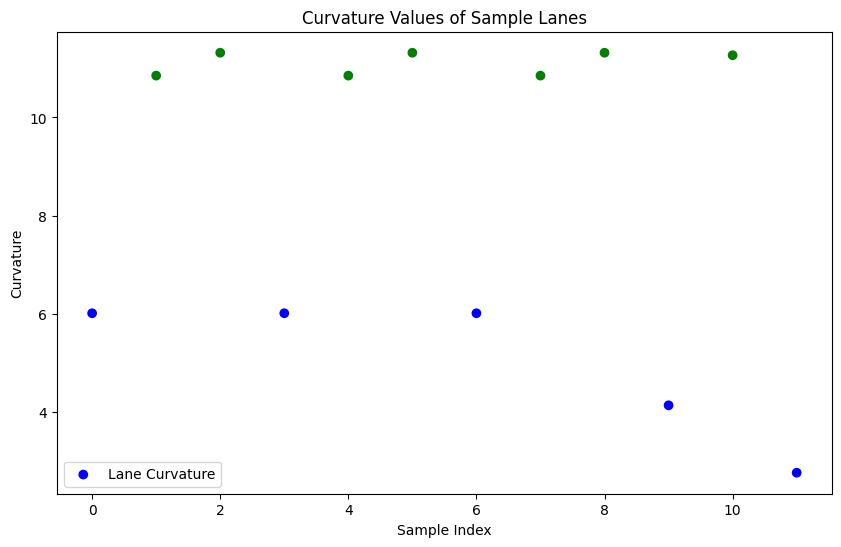

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(range(len(curvature_df)), curvature_df['Curvature'], c=curvature_df['Category'].map({'Straight': 'blue', 'Curved': 'green'}), label='Lane Curvature')
plt.title('Curvature Values of Sample Lanes')
plt.xlabel('Sample Index')
plt.ylabel('Curvature')
plt.legend()
plt.show()

Most of the samples (green points) are classified as 'Curved', which aligns with the previous bar chart showing a higher count of curved lanes.
Fewer samples (blue points) are classified as 'Straight', indicating such lanes are less common in the dataset.
The plot shows a clear distinction between the two categories based on the chosen threshold value of 10 for curvature.






<Figure size 800x600 with 0 Axes>

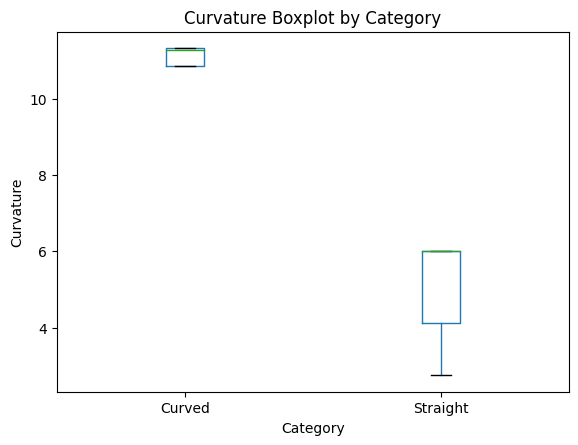

In [ ]:
plt.figure(figsize=(8, 6))
curvature_df.boxplot(column='Curvature', by='Category', grid=False)
plt.title('Curvature Boxplot by Category')
plt.suptitle('')  # Suppress the default title
plt.xlabel('Category')
plt.ylabel('Curvature')
plt.show()


Curved Category: The 'Curved' boxplot is a narrow box, indicating that the curvature values for lanes classified as 'Curved' are very consistent and close to the threshold value that defines them as curved (just above 10).

Straight Category: The 'Straight' boxplot has a larger interquartile range, showing more variability in the curvature values, but all are below the threshold that classifies them as straight.

Median Lines: The line inside each box indicates the median curvature value for each category. Both medians are centrally located within their boxes, suggesting a symmetrical distribution of curvature values within both categories.

No Outliers: There appear to be no outliers in either category, as there are no points beyond the whiskers of the boxes.



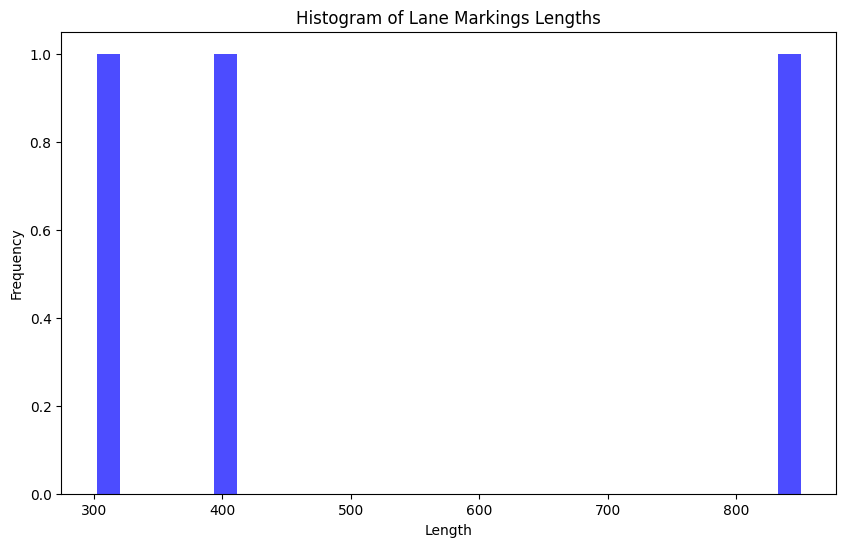

In [ ]:
import matplotlib.pyplot as plt

# Assuming 'coordinates' is your DataFrame containing lane markings data
# Calculate lengths of each lane marking
lane_lengths = coordinates.groupby('LineID').apply(lambda x: x[['X', 'Y']].diff().pow(2).sum(axis=1).pow(0.5).sum())

plt.figure(figsize=(10, 6))
plt.hist(lane_lengths, bins=30, color='blue', alpha=0.7)
plt.title('Histogram of Lane Markings Lengths')
plt.xlabel('Length')
plt.ylabel('Frequency')
plt.show()


The histogram shows the distribution of lengths for lane markings. It indicates there are three prominent lengths at which lane markings commonly occur: around 300, 400, and 800 units (the unit of measurement isn't specified but could be meters, feet, etc., depending on the data). The lane markings are not evenly distributed across lengths; instead, they are concentrated at these three lengths, suggesting standardized lane lengths or frequent distances between features like road markings or intersections. There's a very low frequency of lane markings of intermediate lengths between these values.







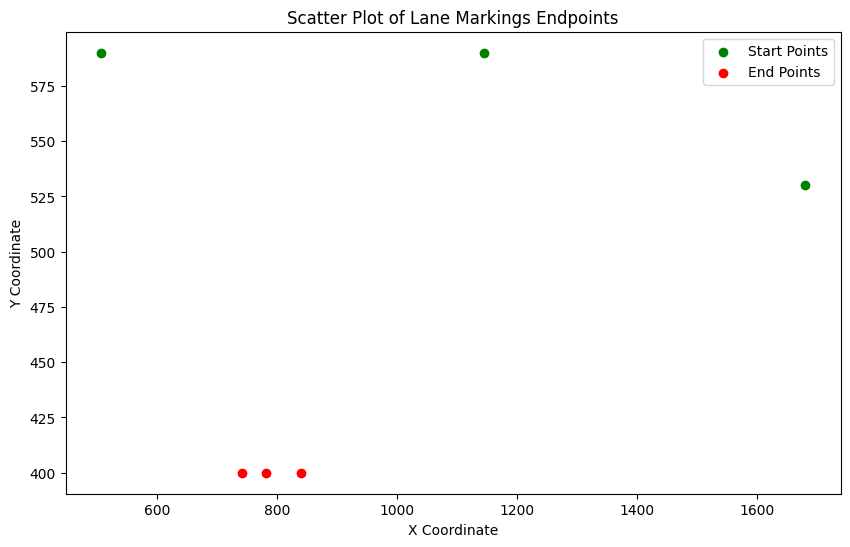

In [ ]:
# Extracting start and end points of each lane marking
start_points = coordinates.groupby('LineID').first()
end_points = coordinates.groupby('LineID').last()

plt.figure(figsize=(10, 6))
plt.scatter(start_points['X'], start_points['Y'], color='green', label='Start Points')
plt.scatter(end_points['X'], end_points['Y'], color='red', label='End Points')
plt.title('Scatter Plot of Lane Markings Endpoints')
plt.xlabel('X Coordinate')
plt.ylabel('Y Coordinate')
plt.legend()
plt.show()


There's a significant distance between the start and end points of lane markings, as indicated by the separation along the x-axis.
The lane markings seem to be almost horizontal, with start and end points sharing approximately the same y-coordinates but varying x-coordinates.
The clustering of end points (red dots) around the lower x-coordinate values suggests that many lane markings may begin from a similar longitudinal position.
The spread of the start points (green dots) across a wider range of x-coordinates indicates more variability in where lane markings end.
The plot shows a directional trend in the lane markings, potentially indicating the flow of traffic or the design of the roadway where the data was collected.






# `**Pre Processing **`

Now we will proceed by resizing the images, normalizing them, and subsequently converting the lines into masks using binary segmentation. Also we won't be doing data argumentation

Resizing images to a consistent size is crucial for deep learning because neural networks require uniform input dimensions. This ensures that the model can process all images in a consistent manner, making it easier to design and train the network.

Image normalization involves scaling pixel values to a standardized range, typically [0, 1] or [-1, 1]. This process helps the model converge faster during training by reducing the impact of varying pixel value ranges in different images. Normalization also aids in better weight initialization and gradient flow, ultimately improving the model's ability to learn meaningful features from the data.


Data augmentation in lane detection datasets is challenging because it can disrupt the semantic integrity of road scenes, create label inconsistencies, introduce unrealistic features, complicate model evaluation, and potentially raise ethical concerns related to altering sensitive information in images.







In [ ]:
class LanesDataset(utils.Dataset):

    dir_images=[]
    dir_lanes=[]
    width=256
    lenght=256
    images=np.ndarray(shape=(1, lenght,width, 3),dtype=np.uint8)
    lanes=np.ndarray(shape=(1, lenght,width),dtype=np.uint8)
    samples_ids=[]



    def convert_mask(self,image,figures,height,width):

        maskblack = np.all(image == (0, 0, 0), axis=-1)
        shapes=figures
        zeros=shapes[shapes==0]
        shapes=shapes[shapes!=0]

        num_shapes=len(shapes)
        pixels = np.ndarray(shape=(height,width,num_shapes),dtype=np.uint8)

        pixels = numpy.zeros(((height,width,num_shapes)))


        if shapes.any():
            k=0
            for shape in shapes:
                pos=np.where( image == shape )
                pixels[:,:,k][pos]=1
                k=k+1

        return (shapes,pixels)

    def load_lanes(self,count, height, width):

        item = list(range(count))
        i=0
        for sample_image in tqdm(self.dir_images,desc="Images"):
            #Gives back a vector of shapes with the shapes in the image (forward and/or backward in our case) and position
            imageshape=self.lanes[i]
            figures=self.samples_ids[i]
            shape,mask=self.convert_mask(imageshape,figures,self.height,self.width)
            self.add_image("lanes",image_id=i,path=sample_image,lanes=shape)
            i=i+1


    def load_image(self, image_id):
        info = self.image_info[image_id]
        image=self.images[image_id]

        return image

    def load_mask(self, image_id):
        info = self.image_info[image_id]
        imagemask=self.lanes[image_id]
        figures=self.samples_ids[image_id]
        (shape,mask)=self.convert_mask(imagemask,figures,self.height,self.width)
        return mask, shape.astype(np.int32)

    def image_reference(self, image_id):
        info = self.image_info[image_id]
        return info["lanes"]



In [ ]:
dataset_train = LanesDataset()
dataset_train.load_LanesDataset(sample_images,sample_lanes,train_images,train_lanes,samples_ids)
dataset_train.load_lanes(len(train_images), 256,256)
dataset_train.prepare()


Images: 100%|██████████| 88879/88879 [00:54<00:00, 1622.76it/s]


Lets Visualize few images and their masked lines

0


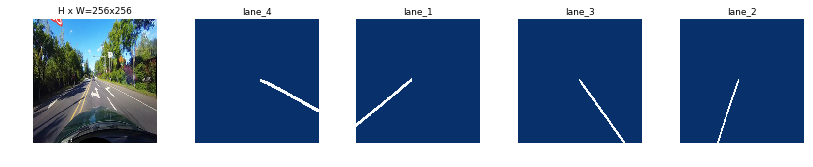

1


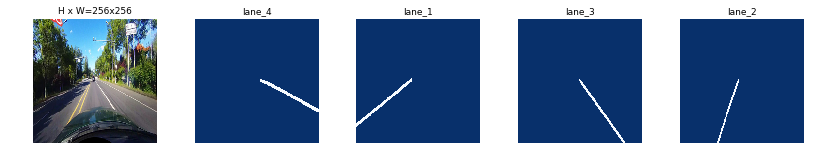

2


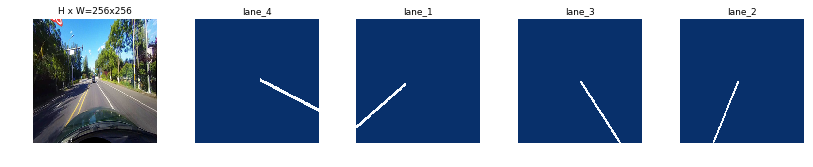

3


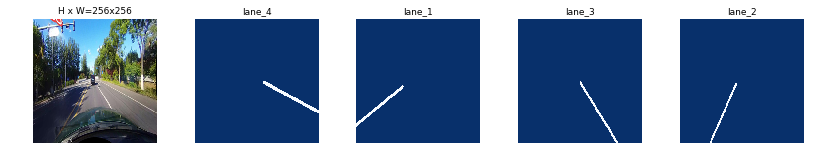

4


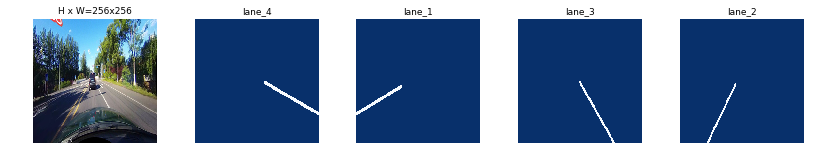

5


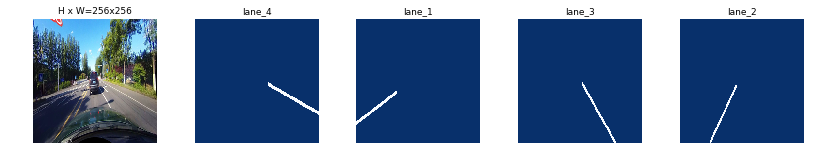

6


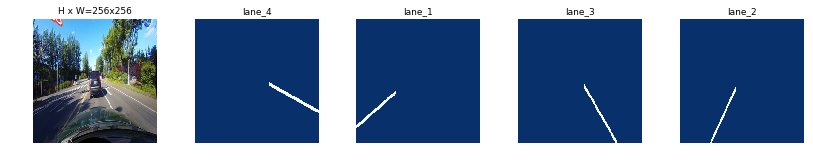

7


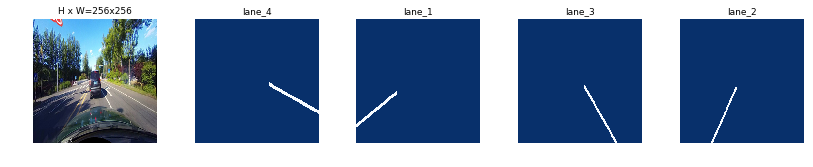

8


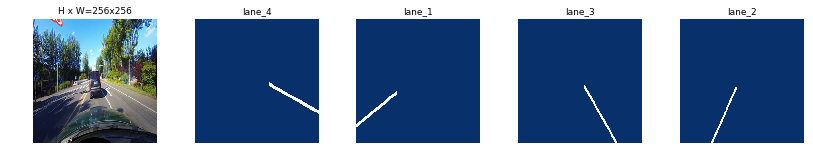

9


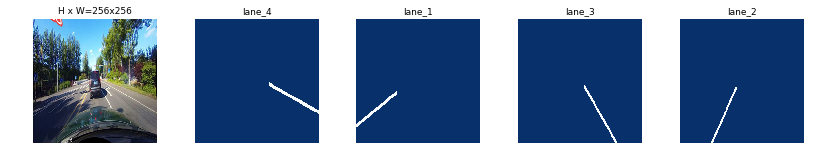

In [ ]:
# Load and display random samples from the training set

image_ids = range(0,10)

for image_id in image_ids:
    print(image_id)

    image = dataset_train.load_image(image_id)
    mask, class_ids = dataset_train.load_mask(image_id)
    unique_class_ids = np.unique(class_ids)
    visualize.display_top_masks(image, mask, class_ids, dataset_train.class_names,limit=4)

Lets visualize the images with masked line on it

Processing folder: 06030819_0755.MP4


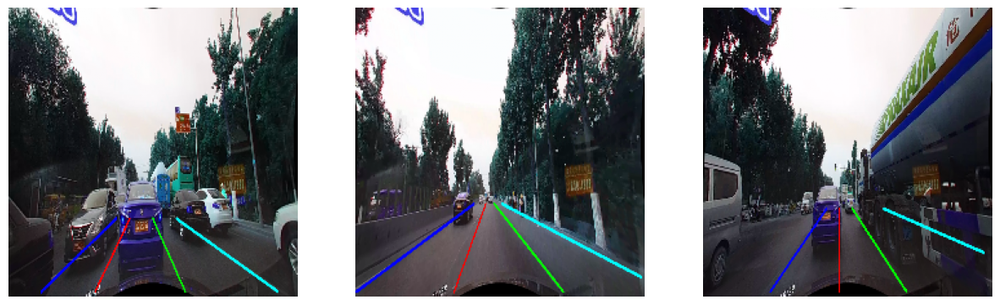

Processing folder: 06030843_0763.MP4


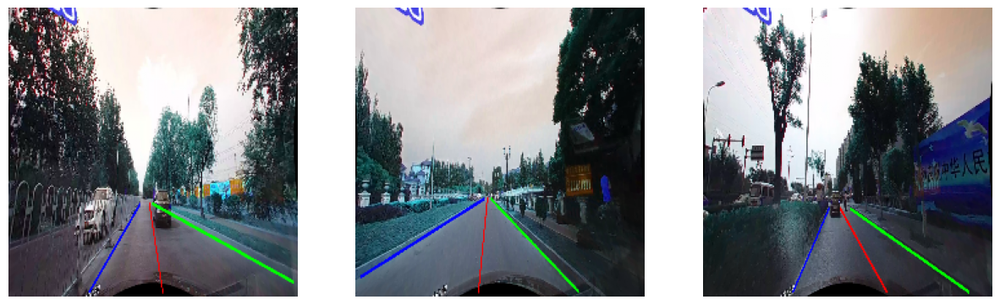

Processing folder: 06030834_0760.MP4


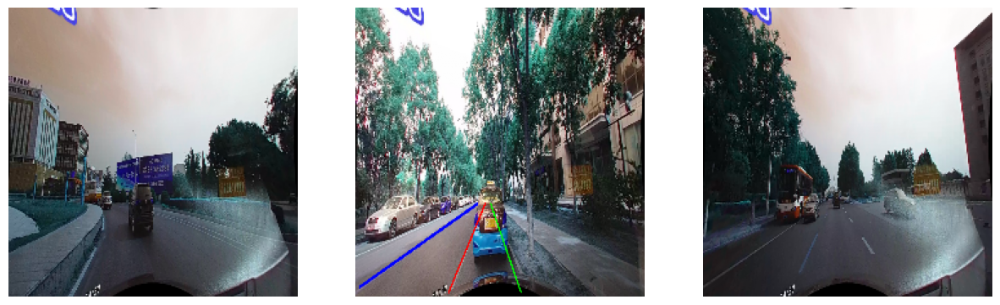

Processing folder: 06030828_0758.MP4


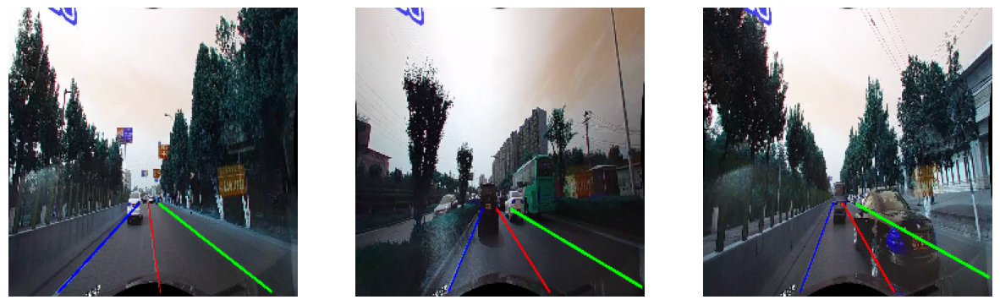

Processing folder: 06030837_0761.MP4


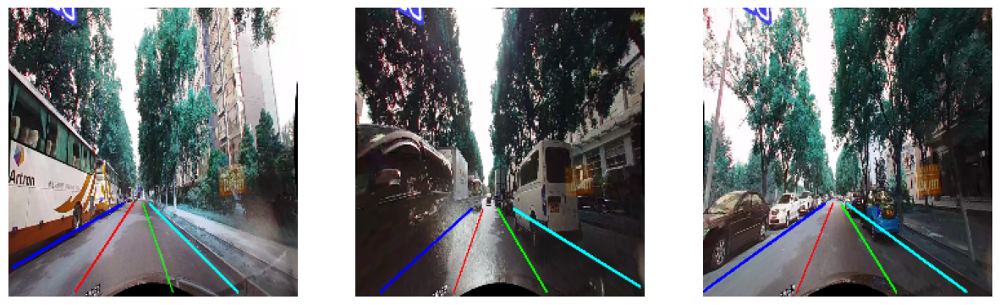

Processing folder: 06030840_0762.MP4


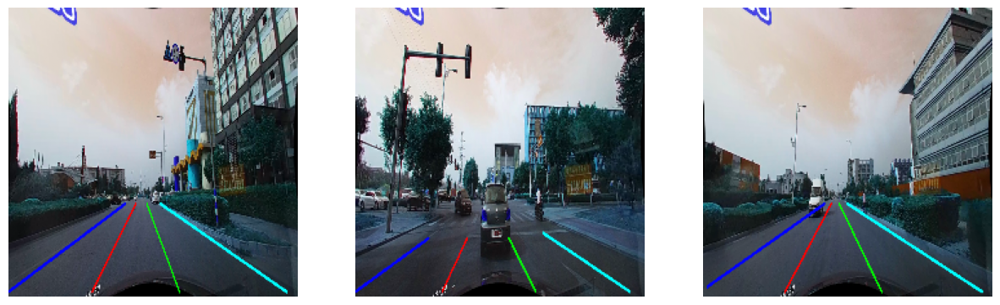

Processing folder: 06030825_0757.MP4


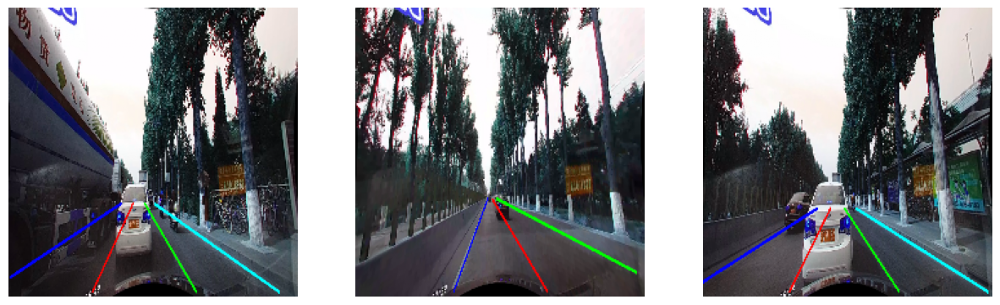

Processing folder: 06030822_0756.MP4


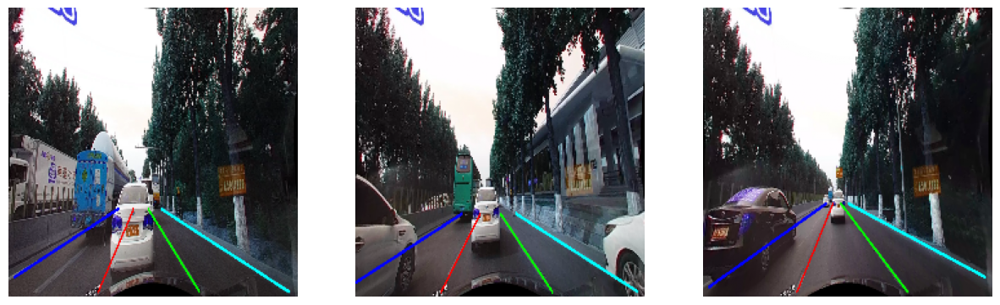

Processing folder: 06030846_0764.MP4


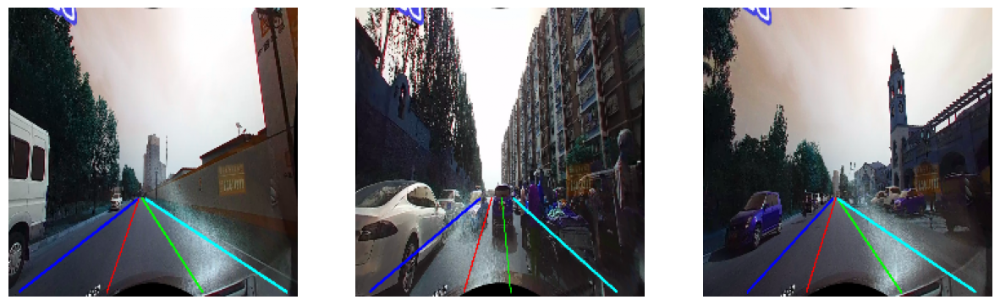

Processing folder: 06030831_0759.MP4


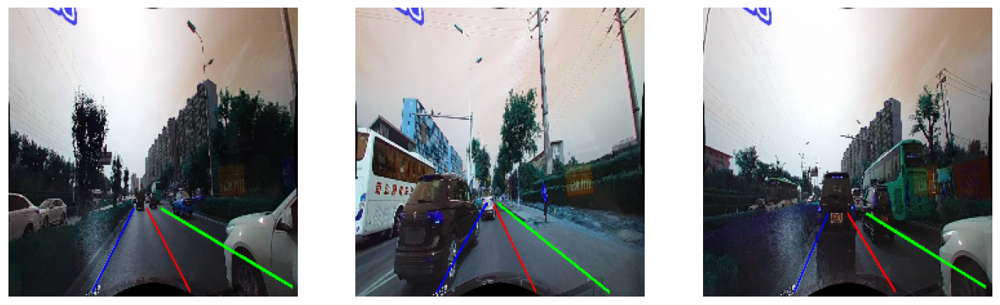

In [ ]:
import cv2
def apply_line_annotations(image_path, line_annotations_path, target_size=(224, 224), debug=False):
    # Load the image
    image = cv2.imread(image_path)

    # Check if the line annotations file exists
    if os.path.exists(line_annotations_path):
        with open(line_annotations_path, 'r') as file:
            lines = file.readlines()

        colors = [(0, 0, 255), (255, 0, 0), (0, 255, 0), (0, 255, 255)]  # Red, Blue, Green, Yellow
        for index, line in enumerate(lines):
            points = line.split()
            if len(points) % 2 == 0:
                coordinates = []
                for i in range(0, len(points), 2):
                    try:
                        x, y = map(float, points[i:i+2])
                        x, y = map(int, [round(x), round(y)])
                        if 0 <= x < image.shape[1] and 0 <= y < image.shape[0]:
                            coordinates.append([x, y])
                    except ValueError:
                        continue

                if coordinates:
                    color = colors[index % len(colors)]
                    cv2.polylines(image, [np.array(coordinates)], isClosed=False, color=color, thickness=5)

    # Resize the image to the target size
    resized_image = cv2.resize(image, target_size)

    # Normalize the image
    normalized_image = resized_image / 255.0

    return normalized_image



def process_and_display_resized_images(base_folder, num_images_to_display=3):
    for folder_name in os.listdir(base_folder):
        folder_path = os.path.join(base_folder, folder_name)

        if os.path.isdir(folder_path):
            print(f"Processing folder: {folder_name}")
            plt.figure(figsize=(15, 5))
            count = 0

            for image_file in os.listdir(folder_path):
                if image_file.endswith('.jpg') and count < num_images_to_display:
                    base_name = os.path.splitext(image_file)[0]
                    image_path = os.path.join(folder_path, image_file)
                    line_annotations_path = os.path.join(folder_path, base_name + '.lines.txt')

                    # Apply annotations, resize and normalize
                    processed_image = apply_line_annotations(image_path, line_annotations_path)

                    plt.subplot(1, num_images_to_display, count + 1)
                    plt.imshow(processed_image)
                    plt.axis('off')
                    count += 1

            plt.show()

# Process and display the images
base_folder = '/content/drive/MyDrive/extracted/dl data'  # Replace with your dataset path
process_and_display_resized_images(base_folder)


# **Creating a CNN model **

CNN has ability to learn from raw pixel data, it's efficiency in capturing spatial hierarchies, and their robustness to variations in the visual appearance of lanes make cnn better suited for lane detection compared to traditional machine learning models that often require manual feature engineering and may not capture the spatial dependencies as effectively. These characteristics enable CNNs to perform well even in complex driving environments.



In [53]:
import os
import cv2
import numpy as np
import pickle
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import BatchNormalization, Conv2D, MaxPooling2D, UpSampling2D
from tensorflow.keras.layers import Conv2DTranspose, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [54]:
def create_label(line_file, img_size=(224, 224)):
    label = np.zeros(img_size, dtype=np.uint8)
    with open(line_file, 'r') as file:
        for line in file:
            coordinates = line.split()
            # Process as many complete segments as possible
            for i in range(0, len(coordinates) - len(coordinates) % 4, 4):
                try:
                    start_point = (int(float(coordinates[i]) * img_size[1]), int(float(coordinates[i+1]) * img_size[0]))
                    end_point = (int(float(coordinates[i+2]) * img_size[1]), int(float(coordinates[i+3]) * img_size[0]))
                    cv2.line(label, start_point, end_point, (255), 1)
                except IndexError as e:
                    print(f"Error in file {line_file}: {e}")
                    continue
    return label

In [58]:
def preprocess_data(main_folder, img_size=(224, 224)):
    X = []
    y = []
    for folder in os.listdir(main_folder):
        folder_path = os.path.join(main_folder, folder)
        if os.path.isdir(folder_path):
            image_files = [file for file in os.listdir(folder_path) if file.endswith('.jpg')]
            for image_file in image_files:
                image_path = os.path.join(folder_path, image_file)
                line_file = os.path.join(folder_path, image_file.replace('.jpg', '.lines.txt'))

                image = cv2.imread(image_path)
                image = cv2.resize(image, img_size)
                label = create_label(line_file, img_size)

                X.append(image)
                y.append(label)

    return np.array(X, dtype=np.float32) / 255.0, np.array(y, dtype=np.float32).reshape(-1, img_size[0], img_size[1], 1) / 255.0


In [75]:
main_folder = '/content/drive/MyDrive/dl data2/extracted/driver_161_90frame'


In [ ]:
X, y = preprocess_data(main_folder)

X, y = shuffle(X, y)
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1)  # Adjust test_size as needed

In [61]:
def create_model(input_shape):
    model = Sequential()
    model.add(BatchNormalization(input_shape=input_shape))

    pool_size= (2, 2)

    model.add(Conv2D(8, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv1'))

        # Conv Layer 2
    model.add(Conv2D(16, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv2'))

        # Pooling 1
    model.add(MaxPooling2D(pool_size=pool_size))

        # Conv Layer 3
    model.add(Conv2D(16, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv3'))
    model.add(Dropout(0.2))

        # Conv Layer 4
    model.add(Conv2D(32, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv4'))
    model.add(Dropout(0.2))

        # Conv Layer 5
    model.add(Conv2D(32, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv5'))
    model.add(Dropout(0.2))

        # Pooling 2
    model.add(MaxPooling2D(pool_size=pool_size))

        # Conv Layer 6
    model.add(Conv2D(64, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv6'))
    model.add(Dropout(0.2))

        # Conv Layer 7
    model.add(Conv2D(64, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv7'))
    model.add(Dropout(0.2))

        # Pooling 3
    model.add(MaxPooling2D(pool_size=pool_size))

        # Upsample 1
    model.add(UpSampling2D(size=pool_size))

        # Deconv 1
    model.add(Conv2DTranspose(64, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv1'))
    model.add(Dropout(0.2))

        # Deconv 2
    model.add(Conv2DTranspose(64, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv2'))
    model.add(Dropout(0.2))

        # Upsample 2
    model.add(UpSampling2D(size=pool_size))

        # Deconv 3
    model.add(Conv2DTranspose(32, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv3'))
    model.add(Dropout(0.2))

        # Deconv 4
    model.add(Conv2DTranspose(32, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv4'))
    model.add(Dropout(0.2))

        # Deconv 5
    model.add(Conv2DTranspose(16, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv5'))
    model.add(Dropout(0.2))

        # Upsample 3
    model.add(UpSampling2D(size=pool_size))

        # Deconv 6
    model.add(Conv2DTranspose(16, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv6'))



    model.add(Conv2DTranspose(1, (3, 3), padding='valid', strides=(1, 1), activation='relu', name='Final'))

    return model

**Layered Convolutional Architecture**: The alternating pattern of convolutional layers with activation functions like ReLU (Rectified Linear Unit) allows the model to learn complex patterns in the images such as edges, shapes, and eventually, lane lines.

**Pooling Layers**: MaxPooling layers reduce the spatial dimensions of the output from the previous layer, which helps in reducing the computational load, and also makes the detection features somewhat invariant to scale and orientation changes.

**Dropout Layers**: These layers help in preventing overfitting by randomly setting a fraction of input units to 0 at each update during training, which helps in making the model more robust to noise and variations in lane markings.

**Batch Normalization**: This normalizes the input layer by adjusting and scaling the activations, which helps in speeding up the training process and achieving higher performance.

**Conv2DTranspose Layers and Upsampling**: These layers are used for upsampling the feature maps and learning to reconstruct the segmentation map from the condensed feature map. This is important in segmentation tasks like lane detection, where we not only want to classify each pixel but also maintain the spatial hierarchy and resolution.

**Final Conv2DTranspose Layer**: This layer is the final step in transforming the feature maps back into the original image size with the predicted lane markings.



In [76]:
# Create the model
input_shape = X_train.shape[1:]
model = create_model(input_shape)

In [79]:
# Compile the model
model.compile(optimizer='Adam', loss='mean_squared_error', metrics=['accuracy'])

In [78]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 batch_normalization_2 (Bat  (None, 224, 224, 3)       12        
 chNormalization)                                                
                                                                 
 Conv1 (Conv2D)              (None, 222, 222, 8)       224       
                                                                 
 Conv2 (Conv2D)              (None, 220, 220, 16)      1168      
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 110, 110, 16)      0         
 g2D)                                                            
                                                                 
 Conv3 (Conv2D)              (None, 108, 108, 16)      2320      
                                                                 
 dropout_4 (Dropout)         (None, 108, 108, 16)     

In [80]:
from tensorflow.keras.callbacks import Callback
import matplotlib.pyplot as plt

class VisualizePredictions(Callback):
    def __init__(self, model):
        self.model = model


    def on_epoch_end(self, epoch, logs=None):
        sample_idx = np.random.choice(range(len(X_train)))
        x_val_sample, y_val_sample = X_train[sample_idx], y_train[sample_idx]
        y_pred_sample = self.model.predict(np.expand_dims(x_val_sample, axis=0))[0]

        plt.figure(figsize=(12, 4))
        plt.subplot(1, 3, 1)
        plt.title('Input')
        plt.imshow(x_val_sample)
        plt.subplot(1, 3, 2)
        plt.title('True Mask')
        plt.imshow(y_val_sample[:, :, 0], cmap='gray')
        plt.subplot(1, 3, 3)
        plt.title('Predicted Mask')
        plt.imshow(y_pred_sample[:, :, 0], cmap='gray')
        plt.show()

After each training epoch, it selects a random training example, generates a prediction for that example using the model, and then plots the input image, the true mask (actual label), and the predicted mask side by side. This helps in monitoring how the model's predictions are improving over time.







In [ ]:
datagen = ImageDataGenerator(channel_shift_range=0.2)
datagen.fit(X_train)
visualize_predictions = VisualizePredictions(model)

In [ ]:
model.fit_generator(datagen.flow(X_train, y_train, batch_size=8), steps_per_epoch=len(X_train) / 8, epochs=10, verbose=1,callbacks=[visualize_predictions])


In [ ]:
model.save('full_CNN_model_lane_detection.h5')

# Transfer learning MASK RCNN

In [ ]:
# Create model in training mode
import model as modellib
from tqdm import tqdm

COCO_MODEL_PATH = 'content/mask_rcnn_coco.h5'
model = modellib.MaskRCNN(mode="training", config=config,
                          model_dir=MODEL_DIR)

In [ ]:
init_with = "last"  # imagenet, coco, or last

if init_with == "imagenet":
    model.load_weights(model.get_imagenet_weights(), by_name=True)
elif init_with == "coco":

    model.load_weights(COCO_MODEL_PATH, by_name=True,
                       exclude=["mrcnn_class_logits", "mrcnn_bbox_fc",
                                "mrcnn_bbox", "mrcnn_mask"])
elif init_with == "last":
    model.load_weights(model.find_last()[1], by_name=True)

# Training the model
Train the head branches
Passing layers="heads" freezes all layers except the head
layers. we can also pass a regular expression to select
which layers to train by name pattern.

In [ ]:

model.train(dataset_train, dataset_val,
            learning_rate=config.LEARNING_RATE,
            epochs=1,
            layers='heads')

Instructions for updating:
Use the retry module or similar alternatives.

Starting at epoch 0. LR=0.001

Checkpoint Path: /home/facundo/assignment1/Culanes/logs/lanes20180602T1014/mask_rcnn_lanes_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_cla

In [ ]:
# Save weights
# Typically not needed because callbacks save after every epoch
# Uncomment to save manually
model_path = os.path.join(MODEL_DIR, "mask_rcnn_lanes.h5")
model.keras_model.save_weights(model_path)


In [ ]:
model.train(dataset_train, dataset_val,
            learning_rate=config.LEARNING_RATE,
            epochs=7,
            layers='heads')
model_path = os.path.join(MODEL_DIR, "mask_rcnn_lanes.h5")
model.keras_model.save_weights(model_path)

Instructions for updating:
Use the retry module or similar alternatives.

Starting at epoch 6. LR=0.001

Checkpoint Path: /home/facundo/assignment1/Culanes/logs/lanes20180602T1014/mask_rcnn_lanes_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_cla

we see that this Mask R-CNN model has been trained for a single epoch, starting from epoch 6 with a learning rate of 0.001. The training involves fine-tuning certain layers of the model, as listed in the output. The model achieved a total training loss of 0.3642, with various component losses such as RPN class loss, RPN bounding box loss, Mask R-CNN classifier loss, bounding box loss, and mask loss. However, the validation losses are significantly higher than the training losses, suggesting potential overfitting.

## Evaluate in Data

In [ ]:
import re
folder_images=  "/home/facundo/assignment1/Culanes/images"
test_image_list_path = []
val_lane=[]

with open('list/list/test.txt') as f:
    lines = f.read().splitlines()
    for record in tqdm(lines): #assuming gif
        try:
            data= record.split()
            #print(data)
            test_image_list_path.append(folder_images +  data[0])



100%|██████████| 34680/34680 [00:00<00:00, 1076545.06it/s]


In [ ]:

l_val=len(test_image_list_path)
f_val =50
#indices_val = sample(range(l_val),f_val)
indices_val = range(l_val)

sample_images_val = [test_image_list_path[i] for i in indices_val]
sample_lanes_val = []
samples_ids_val = []

In [ ]:
(list_resize_image_val,list_resize_lanes_val)=resize(sample_images_val,sample_lanes_val,256,256)

In [ ]:

# Recreate the model in inference mode
model = modellib.MaskRCNN(mode="inference",
                          model_dir=MODEL_DIR)

# Get path to saved weights
model_path = model.find_last()[1]

# Load trained weights (fill in path to trained weights here)
assert model_path != "", "Provide path to trained weights"
print("Loading weights from ", model_path)
model.load_weights(model_path, by_name=True)

Loading weights from  /home/facundo/assignment1/Culanes/logs/lanes20180602T1014/mask_rcnn_lanes_0008.h5


Let's see how the model works on one of the image

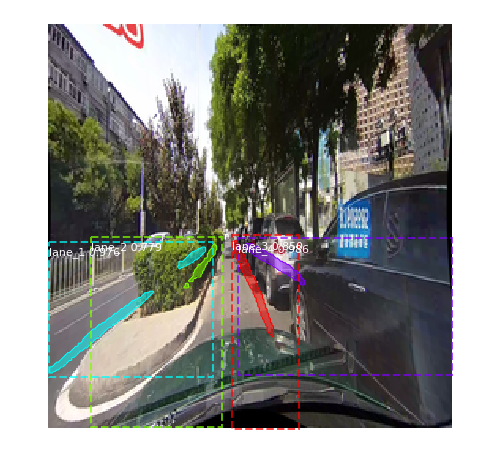

In [ ]:
import visualize
import scipy.misc

im=val_images[1]
#im.size #196608
results = model.detect([im], verbose=0)
r = results[0]
image_out= visualize.display_instances( r['rois'], r['masks'], r['class_ids'],
                                dataset_train.class_names, r['scores'])
type(image_out)

rgb = scipy.misc.toimage(image_out)
imResize = rgb.resize((750,300), Image.ANTIALIAS)
imResize.save('1.jpg')

Lets see how the model performs on multiple images

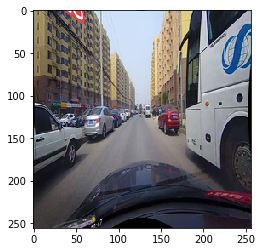

4


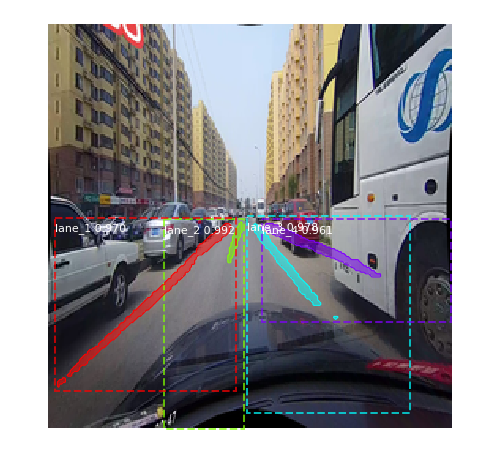

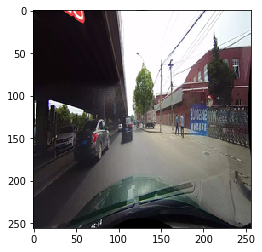

4


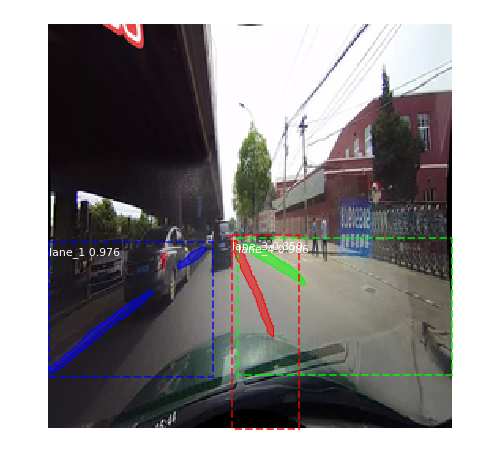

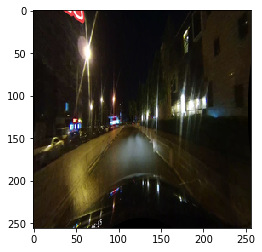

4


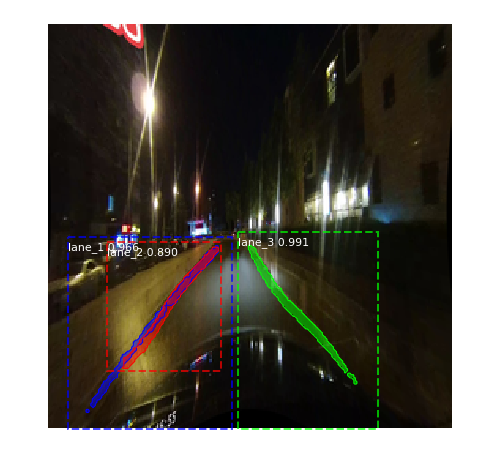

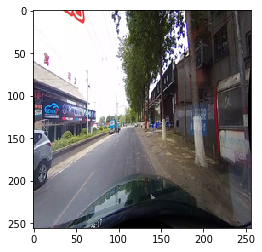

3


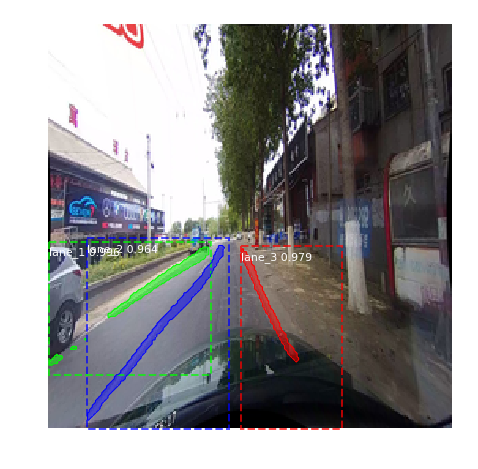

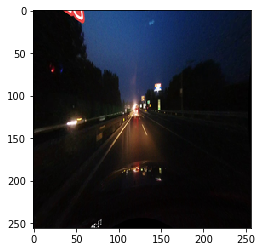

4


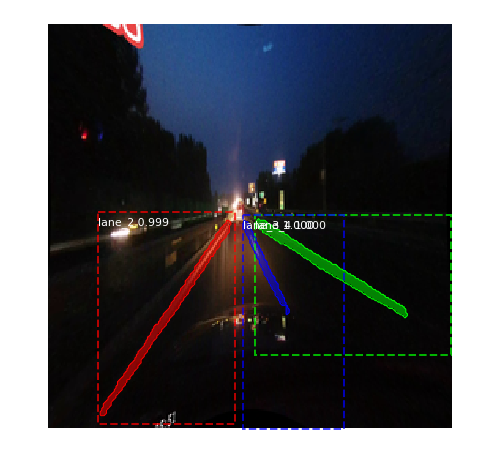

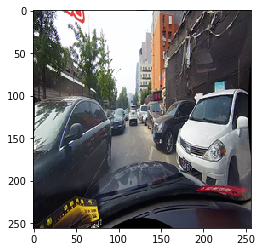

4


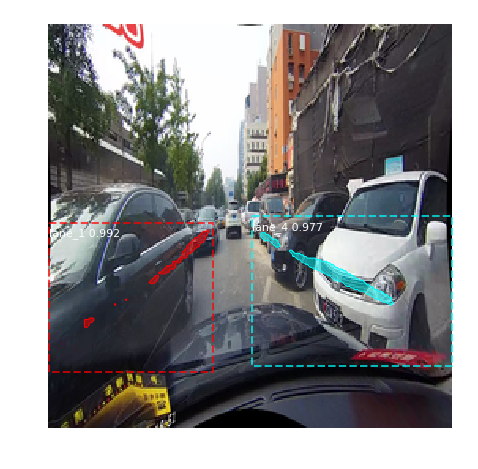

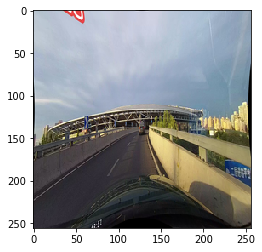

3


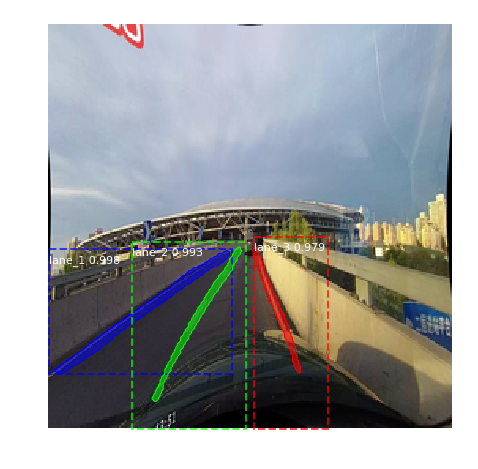

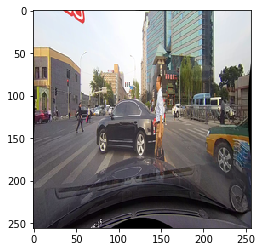

3


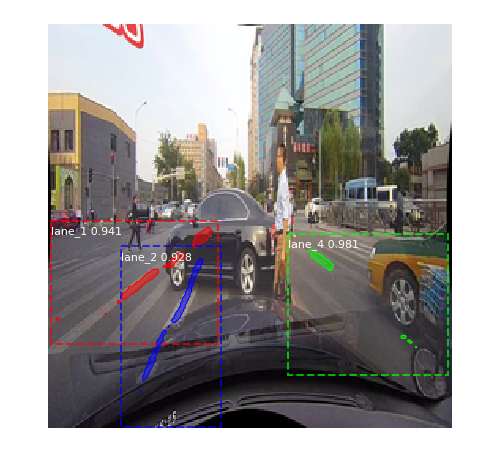

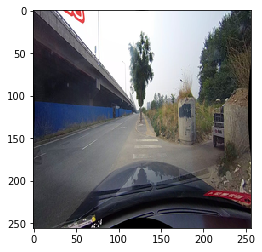

2


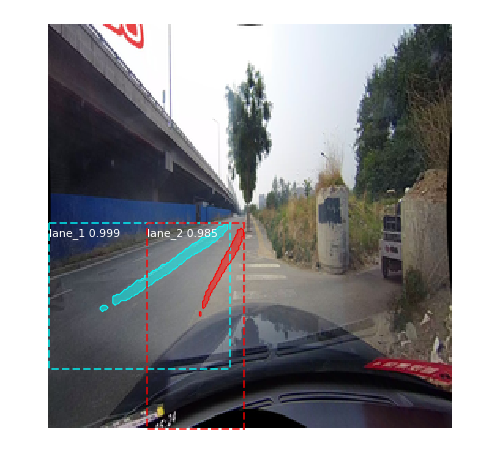

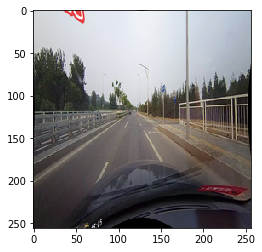

4


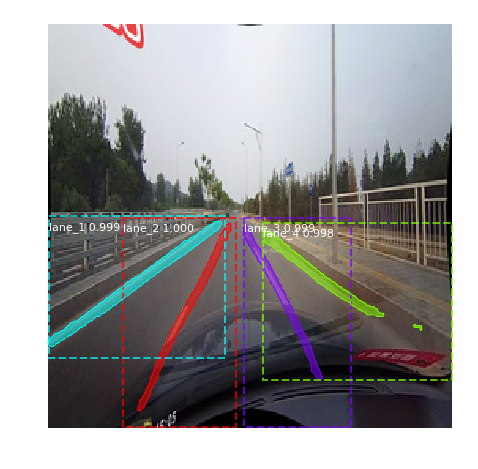

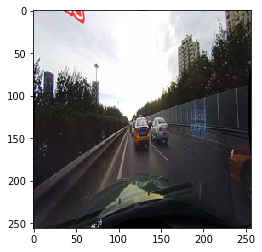

3


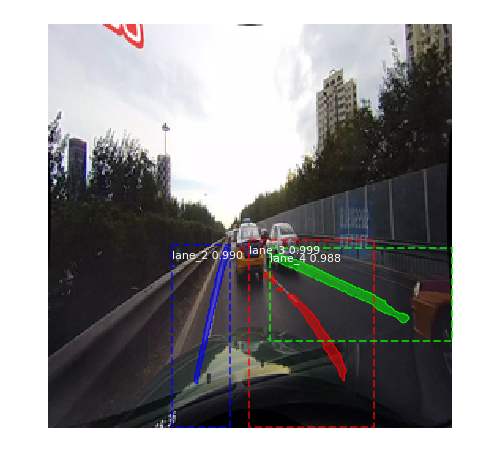

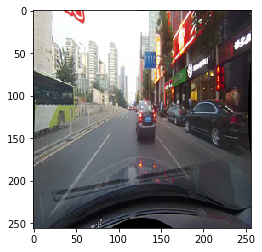

3


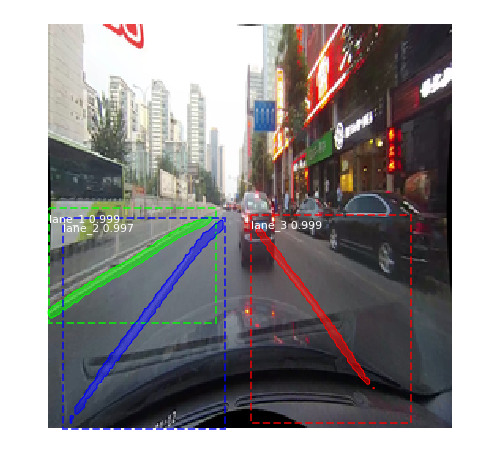

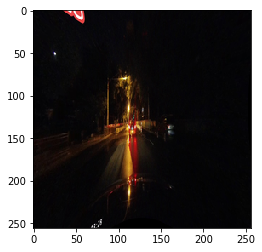

4


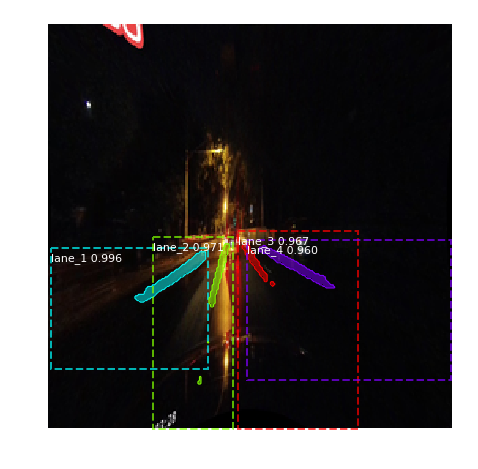

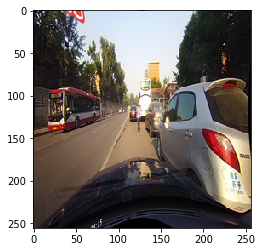

4


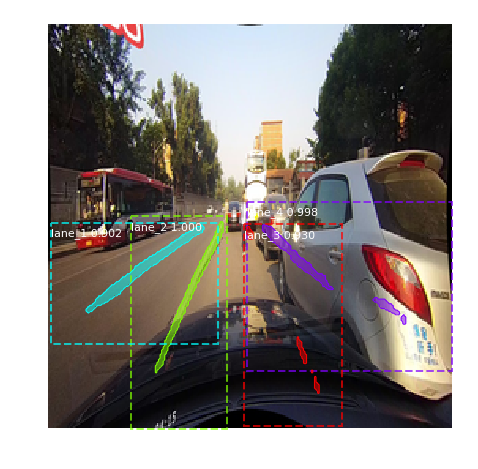

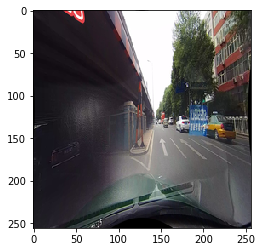

4


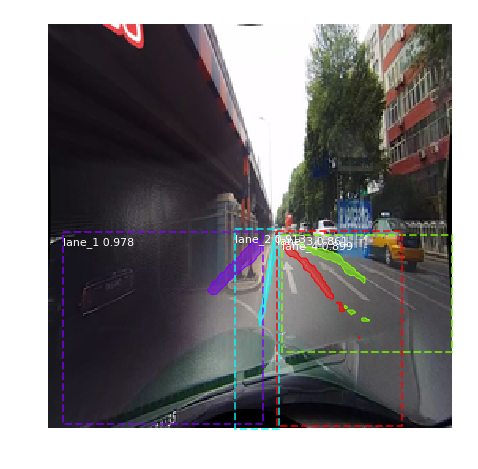

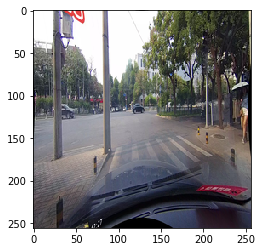

2


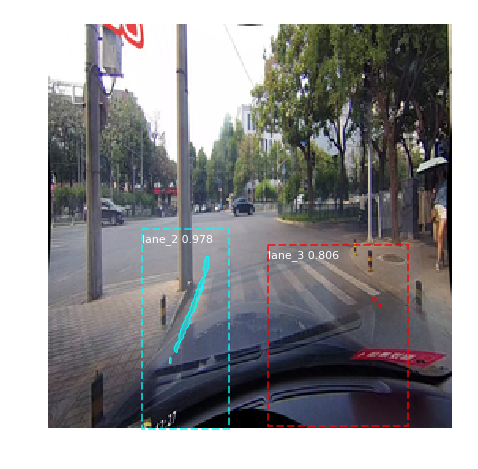

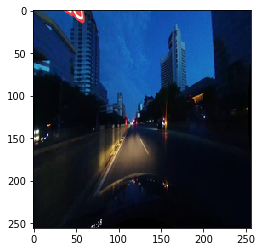

3


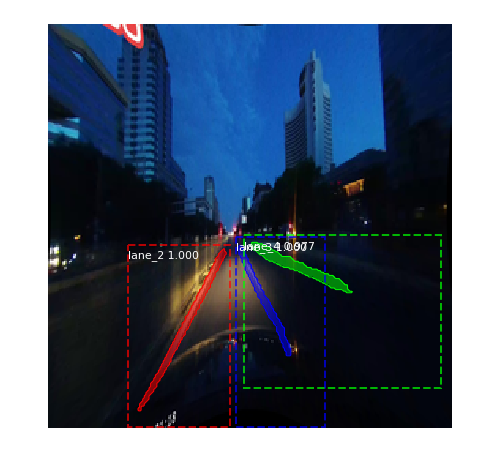

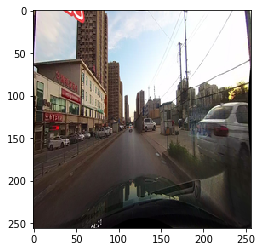

2


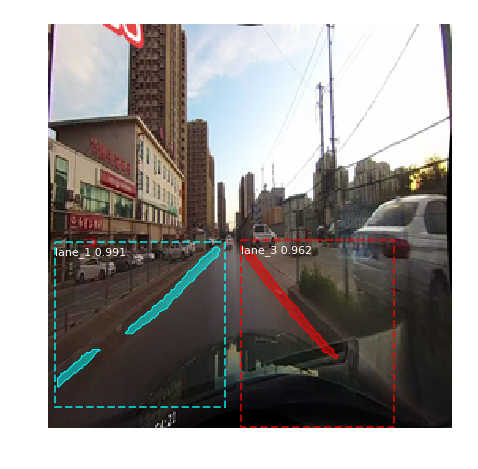

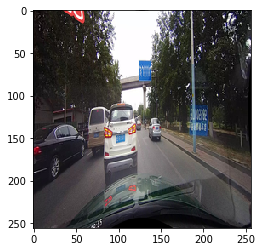

3


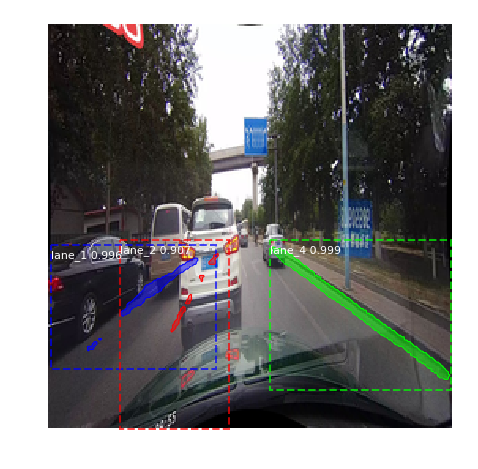

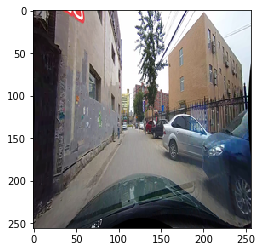

2


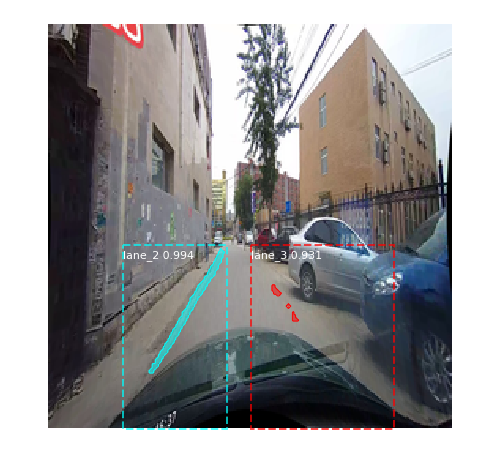

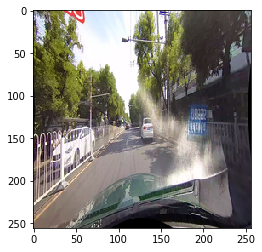

4


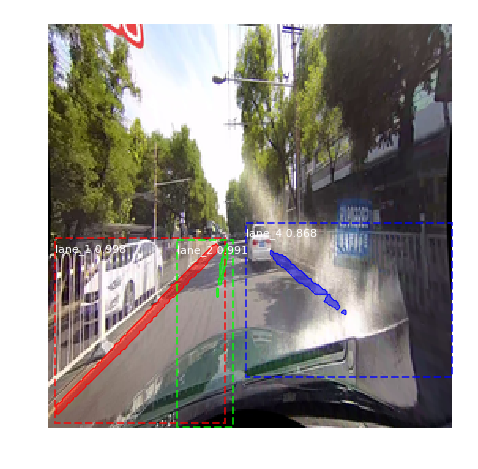

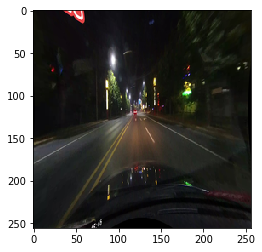

4


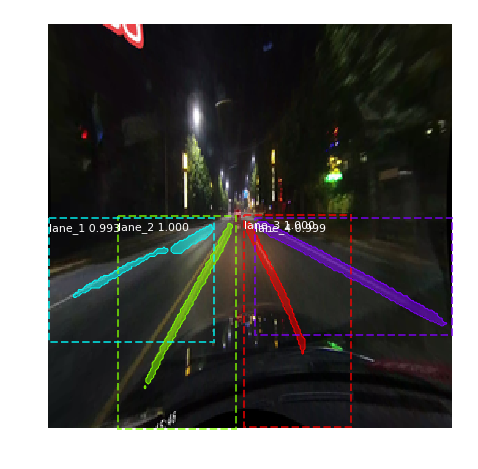

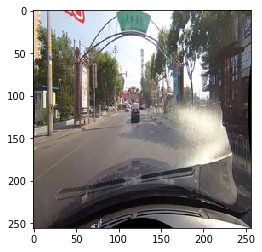

4


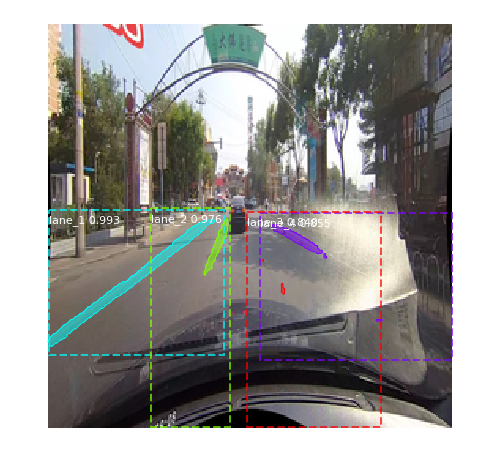

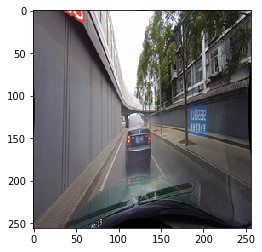

3


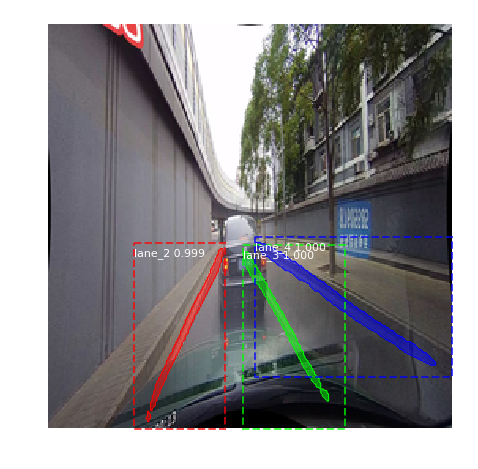

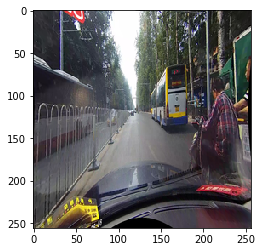

3


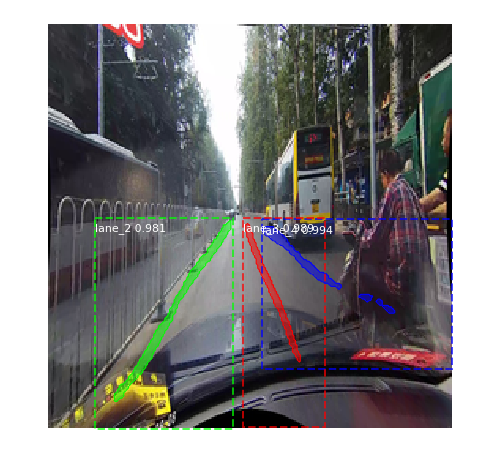

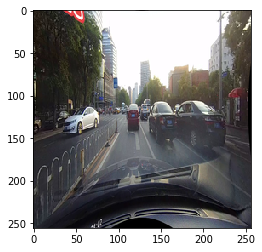

3


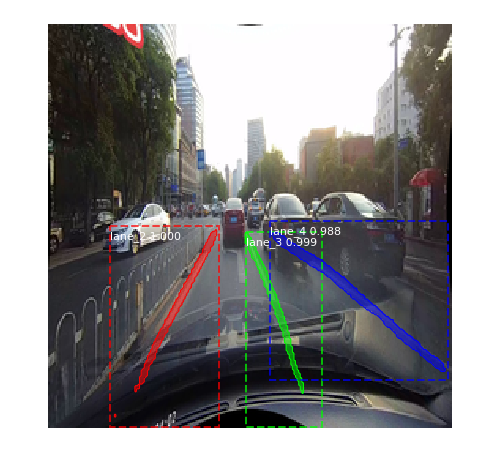

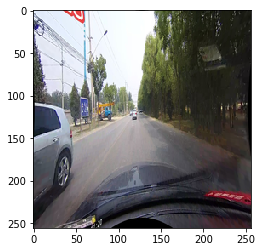

4


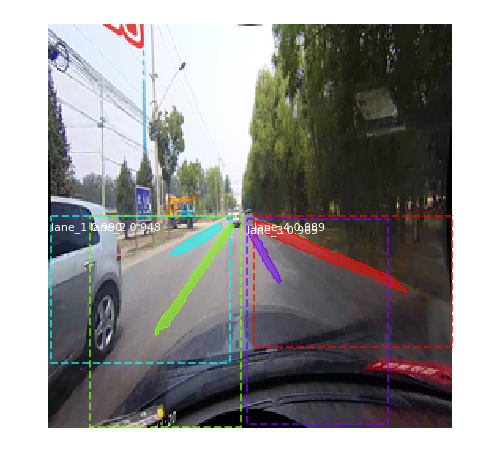

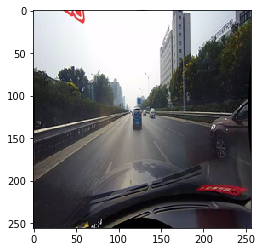

4


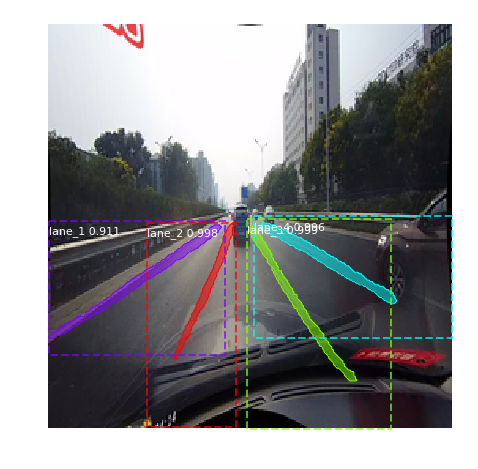

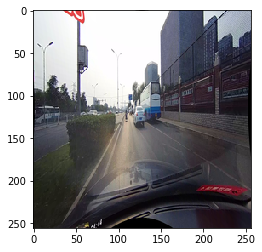

3


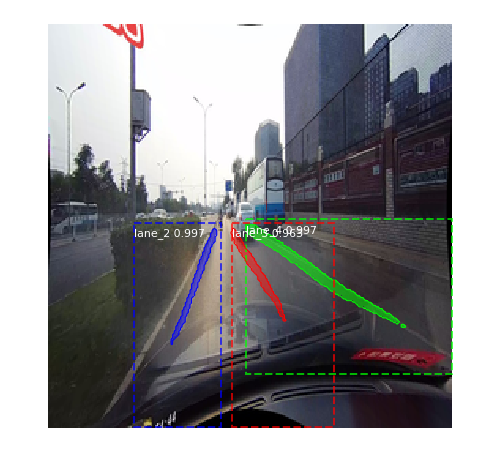

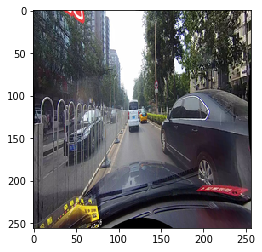

3


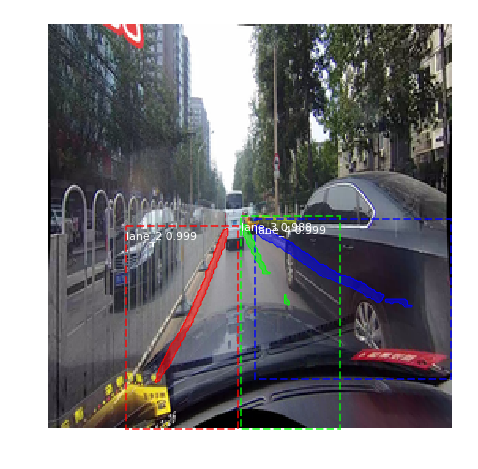

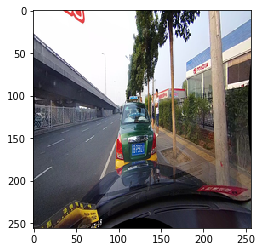

4


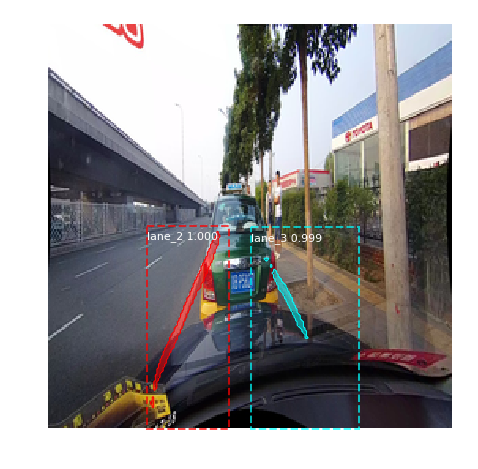

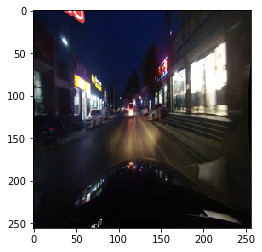

4


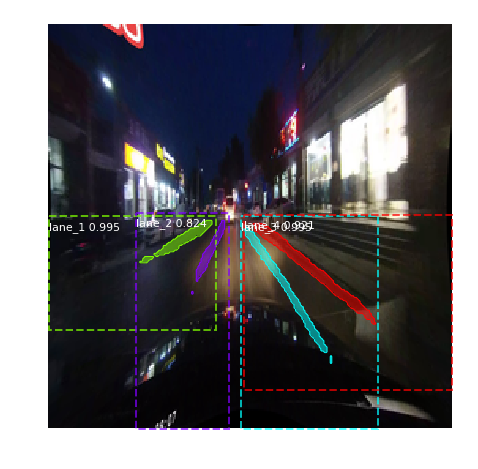

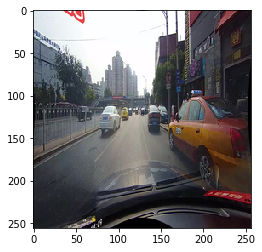

4


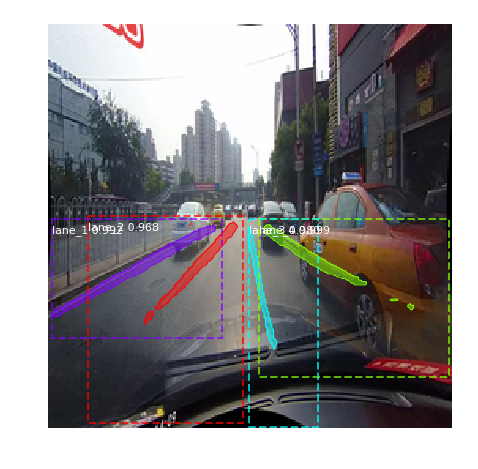

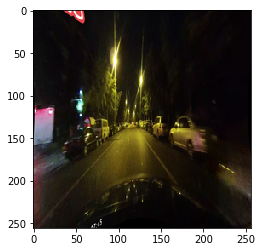

4


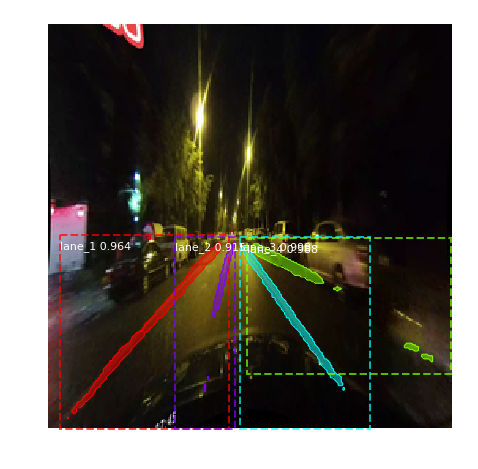

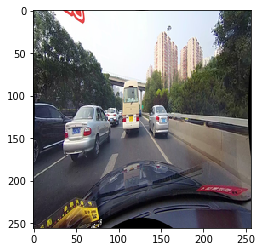

4


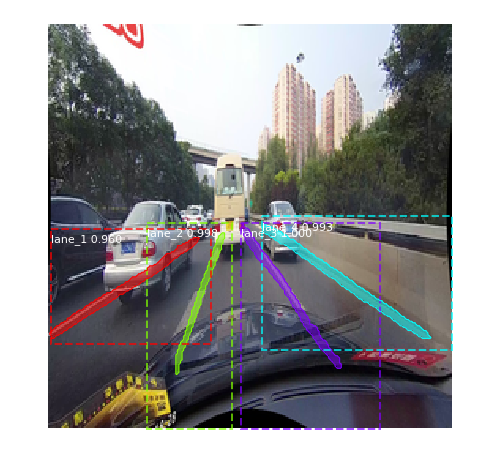

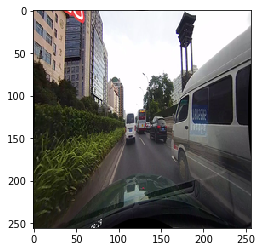

3


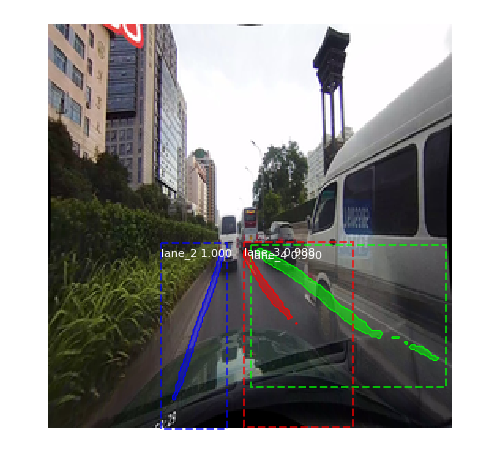

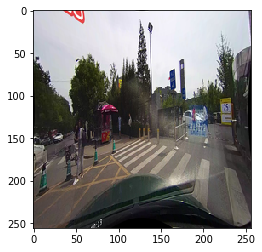

1


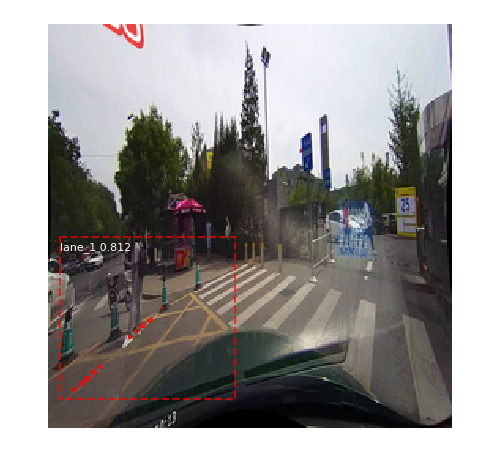

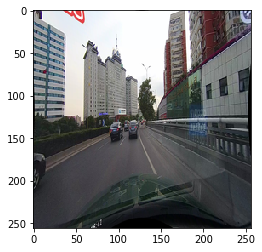

4


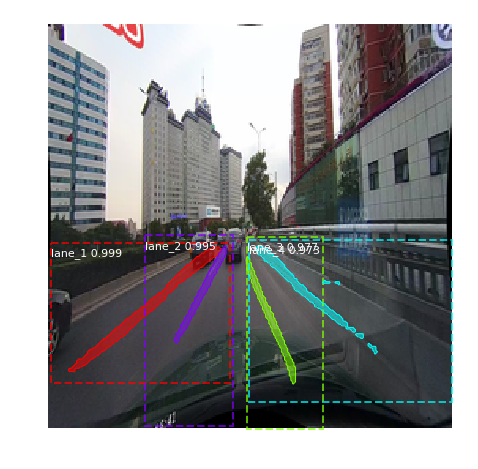

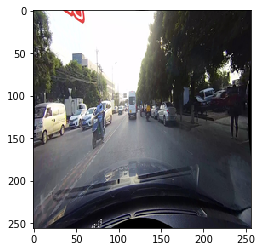

4


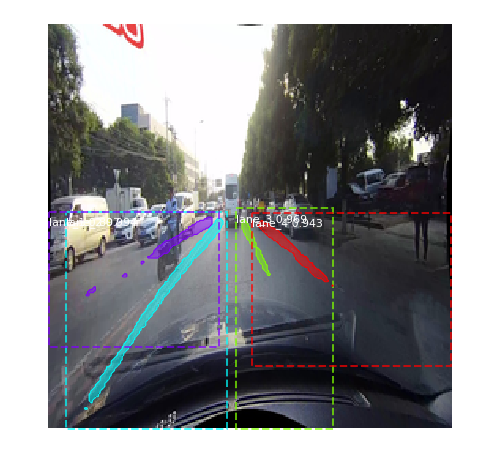

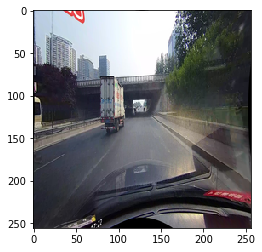

3


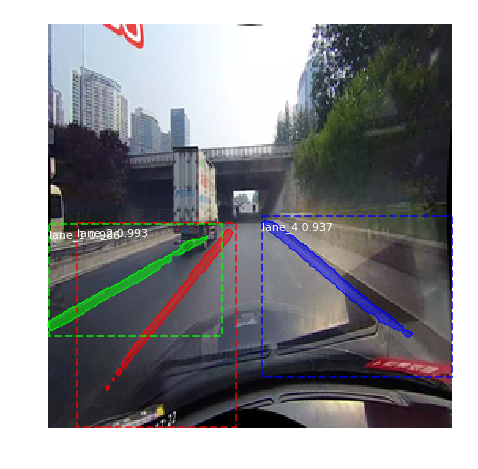

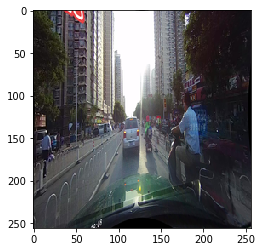

3


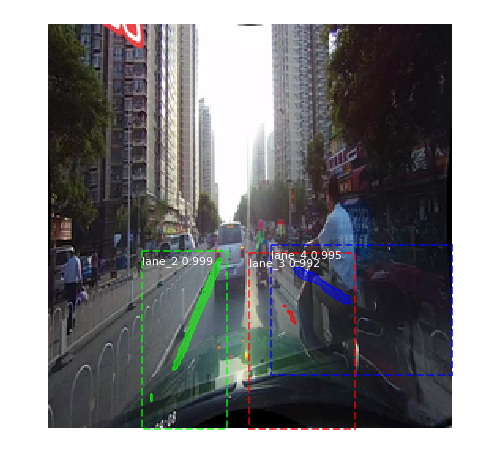

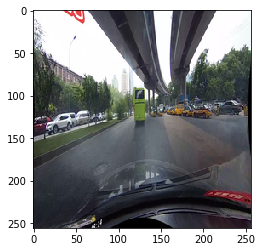

3


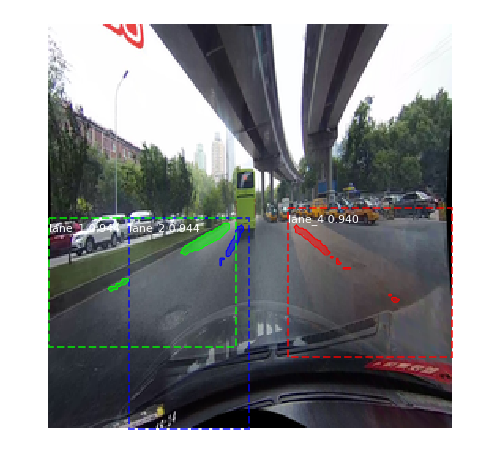

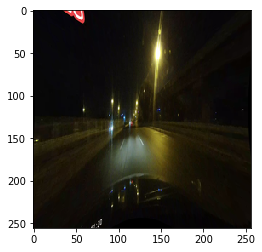

4


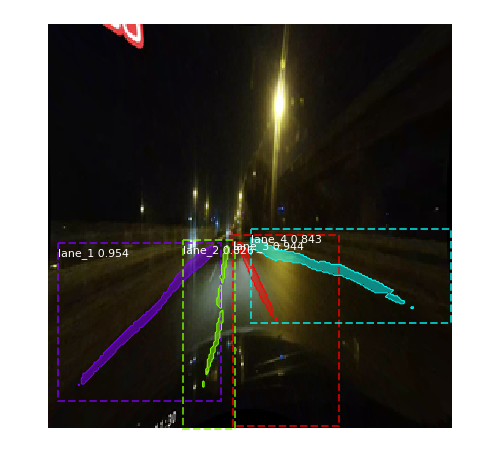

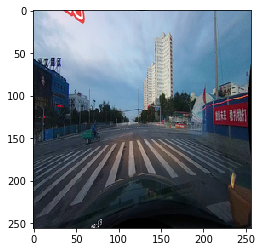

4


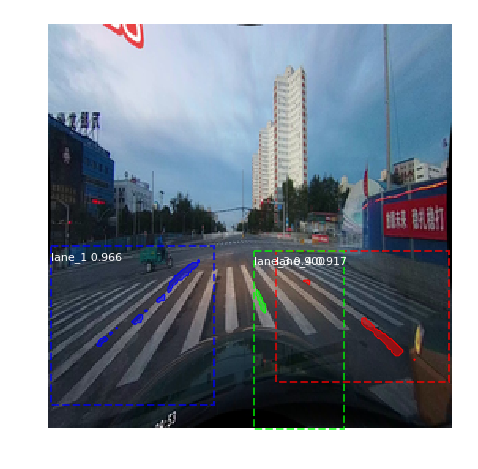

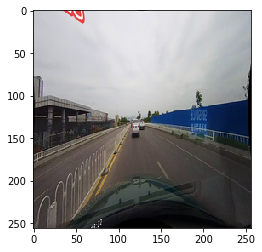

3


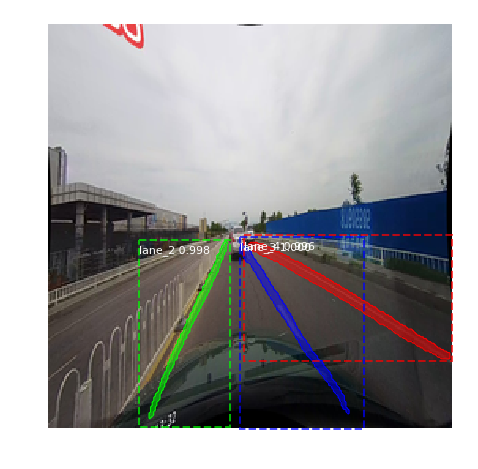

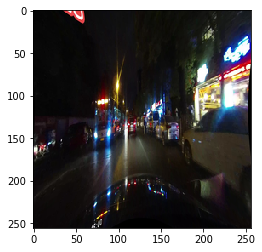

4


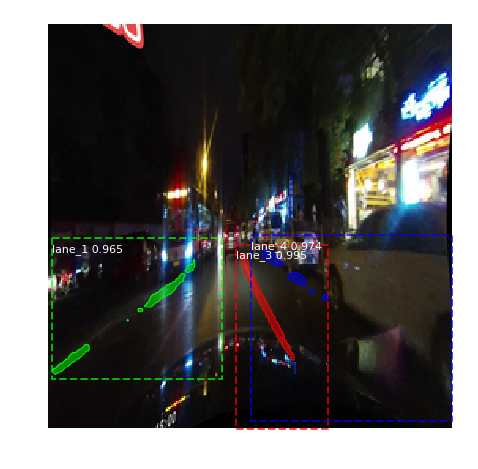

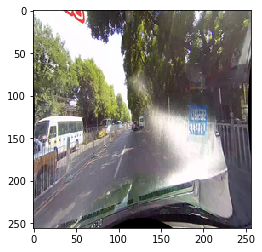

4


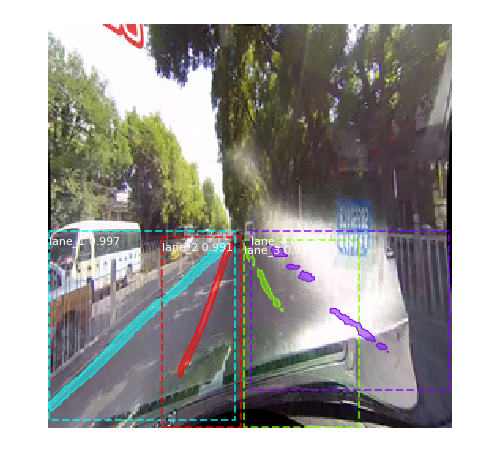

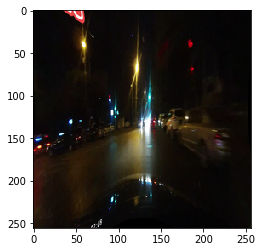

3


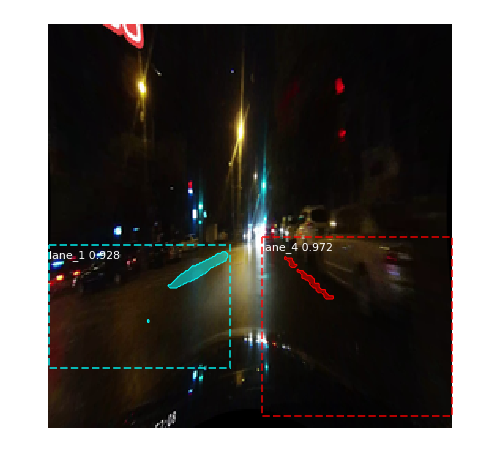

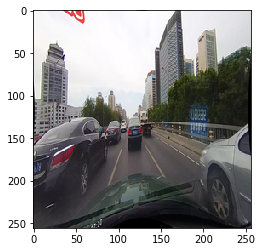

4


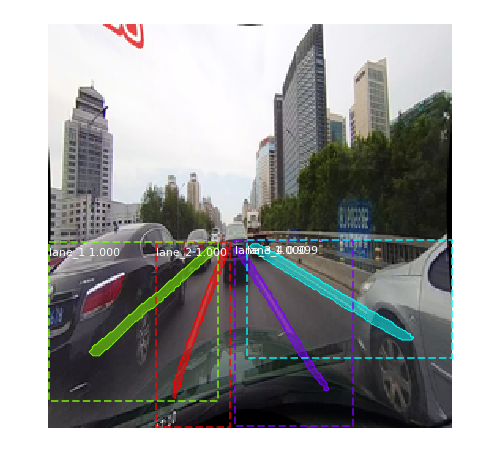

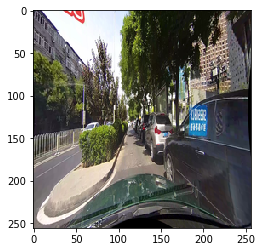

3


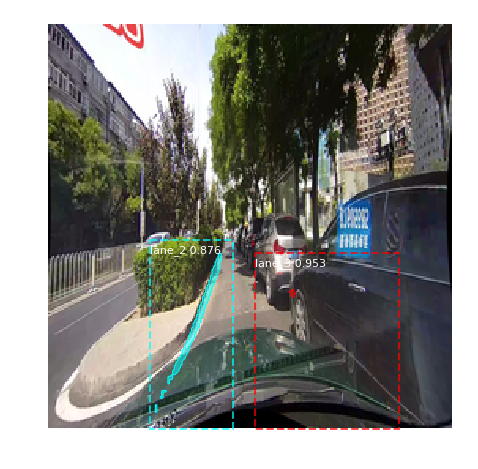

In [ ]:
for im in val_images:
    original_image= im
    fig = plt.figure()
    plt.imshow(original_image)
    plt.show()
    results = model.detect([original_image], verbose=0)

    r = results[0]


    r = results[0]
    good=np.where(r['scores'] > 0.80)

    j=len(good[0])
    scores=r['scores'][np.where(r['scores'] > 0.8)]
    class_ids=r['class_ids'][np.where(r['scores'] > 0.8)]
    rois=r['rois'][np.where(r['scores'] > 0.8)]
    print(len(r['scores']))
    masks=r['masks']
    masks=r['masks'][:,:,0:j]

    visualize.display_instances(original_image, rois, masks, class_ids,
                                dataset_train.class_names, scores)
